# Benchmarking models at locating spatial expression of cell types with scRNA-seq reference and Visium spatial (mouse brain)

In [1]:
import sys, ast, os
import time
import pickle
import scanpy as sc
import anndata
import pandas as pd
import numpy as np
import os
from plotnine import *
import matplotlib.pyplot as plt 
import matplotlib
data_type = 'float32'
os.environ["THEANO_FLAGS"] = 'device=cuda,floatX=' + data_type + ',force_device=True'
# /nfs/team283/vk7/software/miniconda3farm5/envs/cellpymc/bin/pip install git+https://github.com/vitkl/cell2location.git
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/BayraktarLab/cell2location/')
sys.path.insert(1, '/nfs/team205/vk7/sanger_projects/cell2location_dev/')

#import cell2location.models as c2l
#import cell2location.plt as c2lpl
#import cell2location.cluster_averages 
import cell2location
import pymc3 as pm

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
import seaborn as sns
import itertools

# scanpy prints a lot of warnings
import warnings
warnings.filterwarnings('ignore')

/opt/conda/envs/cellpymc/lib/python3.7/site-packages/theano/gpuarray/dnn.py:184: UserWarning: Your cuDNN version is more recent than Theano. If you encounter problems, try updating Theano or downgrading cuDNN to a version >= v5 and <= v7.
Using cuDNN version 7605 on context None
Mapped name None to device cuda: Tesla V100-SXM2-32GB (0000:62:00.0)


`THEANO_FLAGS='force_device=True'` forces the package to use GPU. Pay attention to error messages that might indicate theano failed to initalise the GPU.   
Do not forget to change `device=cuda4` to your available GPU id. Use `device=cuda` / `device=cuda0` if you have just one locally or if you are requesting one GPU via HPC cluster job.

### The purpose of the notebook is to benchmark several versions of the model using mouse brain data.

In [2]:
sc_data_folder = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_data/mouse_visium_snrna/'
sp_data_folder = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/with_tissue_zones/data/'
results_folder = '/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/with_tissue_zones/real_mg/'

## Read datasets and train cell2location

In [3]:
adata = anndata.read(f'{sp_data_folder}synth_adata_real_mg_20210131.h5ad')
adata.uns['spatial'] = {'x': 'y'}

adata_snrna_raw = anndata.read(f'{sp_data_folder}training_5705STDY8058280_5705STDY8058281_20210131.h5ad')

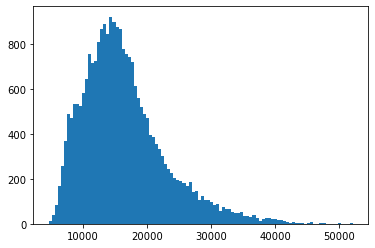

In [4]:
plt.hist(np.array(adata.X.sum(1)).flatten(), bins=100);

In [5]:
sc.pp.calculate_qc_metrics(adata, inplace=True) 

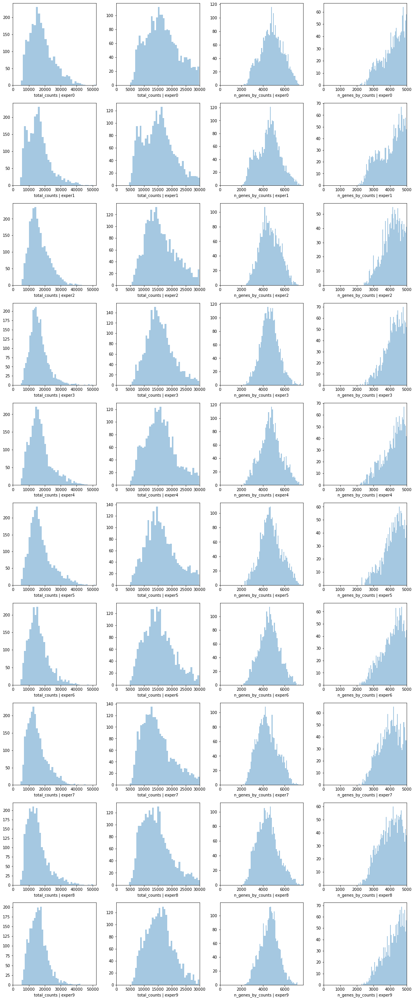

In [6]:
# PLOT QC FOR EACH SAMPLE
fig, axs = plt.subplots(len(adata.obs['sample'].unique()), 4, figsize=(15, 4*len(adata.obs['sample'].unique())-4))
#axs = axs.reshape((len(adata.obs['sample'].unique()), 4))
for i, s in enumerate(adata.obs['sample'].unique()):
    #fig.suptitle('Covariates for filtering')

    #slide = select_slide(adata, s)
    slide = adata[adata.obs['sample'] == s]
    sns.distplot(slide.obs['total_counts'],
                 kde=False, ax = axs[i, 0])
    axs[i, 0].set_xlim(0, adata.obs['total_counts'].max())
    axs[i, 0].set_xlabel(f'total_counts | {s}')

    sns.distplot(slide.obs['total_counts']\
                 [slide.obs['total_counts']<30000],
                 kde=False, bins=40, ax = axs[i, 1])
    axs[i, 1].set_xlim(0, 30000)
    axs[i, 1].set_xlabel(f'total_counts | {s}')

    sns.distplot(slide.obs['n_genes_by_counts'],
                 kde=False, bins=60, ax = axs[i, 2])
    axs[i, 2].set_xlim(0, adata.obs['n_genes_by_counts'].max())
    axs[i, 2].set_xlabel(f'n_genes_by_counts | {s}')

    sns.distplot(slide.obs['n_genes_by_counts']\
                 [slide.obs['n_genes_by_counts']<5000],
                 kde=False, bins=60, ax = axs[i, 3])
    axs[i, 3].set_xlim(0, 5000)
    axs[i, 3].set_xlabel(f'n_genes_by_counts | {s}')

plt.tight_layout()

In [7]:
import scipy
adata_snrna_raw.X = scipy.sparse.csr_matrix(adata_snrna_raw.X)

In [8]:
import scipy
adata.X = scipy.sparse.csr_matrix(adata.X)

Select genes using expression in non-zero cells

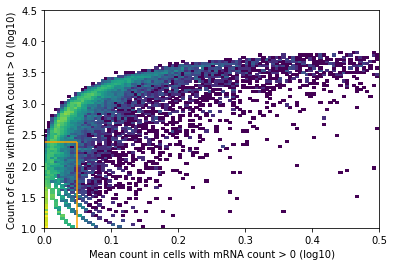

In [9]:
# remove cells and genes with 0 counts everywhere
sc.pp.filter_cells(adata_snrna_raw, min_genes=1)
sc.pp.filter_genes(adata_snrna_raw, min_cells=1)

# calculate the mean of each gene across non-zero cells
adata_snrna_raw.var['n_cells'] = (adata_snrna_raw.X.toarray() > 0).sum(0)
adata_snrna_raw.var['nonz_mean'] = adata_snrna_raw.X.toarray().sum(0) / adata_snrna_raw.var['n_cells']

plt.hist2d(np.log10(adata_snrna_raw.var['nonz_mean']),
           np.log10(adata_snrna_raw.var['n_cells']), bins=100,
           norm=matplotlib.colors.LogNorm(),
           range=[[0,0.5], [1,4.5]]);

nonz_mean_cutoff = np.log10(1.12) # cut off for expression in non-zero cells
cell_count_cutoff = np.log10(adata_snrna_raw.shape[0] * 0.0005) # cut off percentage for cells with higher expression
cell_count_cutoff2 = np.log10(adata_snrna_raw.shape[0] * 0.03)# cut off percentage for cells with small expression

plt.vlines(nonz_mean_cutoff, cell_count_cutoff, cell_count_cutoff2, color = 'orange');
plt.hlines(cell_count_cutoff, nonz_mean_cutoff, 1, color = 'orange');
plt.hlines(cell_count_cutoff2, 0, nonz_mean_cutoff, color = 'orange');
plt.xlabel('Mean count in cells with mRNA count > 0 (log10)');
plt.ylabel('Count of cells with mRNA count > 0 (log10)');

In [10]:
adata_snrna_raw[:,(np.array(np.log10(adata_snrna_raw.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff)].shape

(8111, 12422)

In [11]:
# select genes based on mean expression in non-zero cells
adata_snrna_raw = adata_snrna_raw[:,(np.array(np.log10(adata_snrna_raw.var['nonz_mean']) > nonz_mean_cutoff)
         | np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff2))
      & np.array(np.log10(adata_snrna_raw.var['n_cells']) > cell_count_cutoff)]

In [12]:
adata_snrna_raw

View of AnnData object with n_obs × n_vars = 8111 × 12422
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'sample', 'barcode', 'annotation_1', 'n_genes'
    var: 'feature_types', 'genome', 'SYMBOL', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'n_cells', 'nonz_mean'

Add counts matrix as `adata.raw` 

In [13]:
adata_snrna_raw.raw = adata_snrna_raw

In [14]:
adata_vis = adata.copy()
adata_vis.raw = adata_vis

In [15]:
adata_vis.var_names

Index(['ENSMUSG00000051951', 'ENSMUSG00000089699', 'ENSMUSG00000033845',
       'ENSMUSG00000033813', 'ENSMUSG00000002459', 'ENSMUSG00000033793',
       'ENSMUSG00000025905', 'ENSMUSG00000025907', 'ENSMUSG00000090031',
       'ENSMUSG00000033740',
       ...
       'ENSMUSG00000024993', 'ENSMUSG00000063698', 'ENSMUSG00000024997',
       'ENSMUSG00000003228', 'ENSMUSG00000074733', 'ENSMUSG00000059326',
       'ENSMUSG00000051412', 'ENSMUSG00000079834', 'ENSMUSG00000095041',
       'ENSMUSG00000063897'],
      dtype='object', name='ENSEMBL', length=12809)

In [16]:
adata_vis.var

,gene_level,n_cells_by_counts,mean_counts,log1p_mean_counts,pct_dropout_by_counts,total_counts,log1p_total_counts
ENSEMBL,,,,,,,
ENSMUSG00000051951,0.003928,4909,0.22492,0.202876,80.364,5623,8.634798
ENSMUSG00000089699,0.000026,5,0.00020,0.000200,99.980,5,1.791759
ENSMUSG00000033845,0.697608,13989,1.10868,0.746062,44.044,27717,10.229837
ENSMUSG00000033813,0.430858,11230,0.71892,0.541696,55.080,17973,9.796682
ENSMUSG00000002459,0.070863,14567,0.95816,0.672005,41.732,23954,10.083932
...,...,...,...,...,...,...,...
ENSMUSG00000059326,0.064865,5380,0.25412,0.226434,78.480,6353,8.756840
ENSMUSG00000051412,0.801130,9856,0.66184,0.507925,60.576,16546,9.713960
ENSMUSG00000079834,0.008582,584,0.02376,0.023482,97.664,594,6.388561


In [17]:
from re import sub
adata_snrna_raw.obs['sample'] = [sub('_.+$','', i) for i in adata_snrna_raw.obs.index]

### First, infer average expression in each cell type

In [18]:
adata_snrna_raw

AnnData object with n_obs × n_vars = 8111 × 12422
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'sample', 'barcode', 'annotation_1', 'n_genes'
    var: 'feature_types', 'genome', 'SYMBOL', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mt', 'n_cells', 'nonz_mean'

```python
from cell2location import run_regression
r, adata_snrna_raw = run_regression(adata_snrna_raw, 
                                    
                   verbose=True, return_all=True,
                                 
                   train_args={
                    'covariate_col_names': ['annotation_1'], 
                    'sample_name_col': 'sample',
                    'tech_id': None,
                    'stratify_cv': 'annotation_1',
                       
                    'n_epochs': 100, 'minibatch_size': 1024, 'learning_rate': 0.01,
                       
                    'use_average_as_initial_value': True, 'use_cuda': True,
                       
                    'train_proportion': 0.9,
                    'l2_weight': {'l2_weight': 0.001, 'sample_scaling_weight': 0.5,
                           'gene_overdisp_weight': 0.1},  # True = use defaults for the model
                    
                    'readable_var_name_col': 'SYMBOL', 'use_raw': True},
                                 
                   model_kwargs={},
                   posterior_args={},
                                 
                   export_args={'path': results_folder + 'regression_model/', 'save_model': True,
                                'run_name_suffix': 'with_tissue_zones'})

reg_mod = r['mod']
#adata_snrna_raw = r['sc_data']
```

In [19]:
reg_mod_name = 'RegressionGeneBackgroundCoverageTorch_51covariates_8111cells_12422geneswith_tissue_zones'
reg_path = f'{results_folder}regression_model/{reg_mod_name}/'

adata_snrna_raw = sc.read(f'{reg_path}sc.h5ad')
#r = pickle.load(file = open(f'{reg_path}model_.p', "rb"))
#reg_mod = r['mod']
#r_reg = pickle.load(file = open(f'{reg_path}model_settings.p', "rb"))
#r_reg

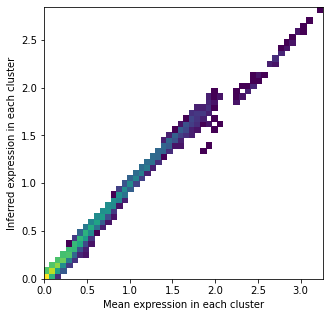

In [20]:
# export inferred averages in each cluster
inf_aver = pd.DataFrame(#adata_snrna_raw.uns['regression_mod']['post_sample_q05']['gene_factors'].T,
                        adata_snrna_raw.uns['regression_mod']['post_sample_means']['gene_factors'].T,
             index=adata_snrna_raw.uns['regression_mod']['var_names'], 
             columns=adata_snrna_raw.uns['regression_mod']['fact_names'])
inf_aver = inf_aver.loc[:, np.array(['annotation_1_' in i for i in inf_aver.columns])]
from re import sub
inf_aver.columns = [sub('annotation_1_', '', i) for i in inf_aver.columns]
inf_aver = inf_aver.iloc[:, inf_aver.columns.argsort()]

# scale up by average sample scaling factor
inf_aver = inf_aver * adata_snrna_raw.uns['regression_mod']['post_sample_means']['sample_scaling'].mean()

# compute mean expression of each gene in each cluster
aver = cell2location.cluster_averages.cluster_averages.get_cluster_averages(adata_snrna_raw, 'annotation_1')
aver = aver.loc[adata_snrna_raw.var_names, inf_aver.columns]

# export inferred averages in each cluster
#inf_aver = reg_mod.covariate_effects.copy()
#from re import sub
#inf_aver.columns = [sub('mean_cov_effect_Subset_', '', i) for i in inf_aver.columns]
#inf_aver = inf_aver.loc[aver.index, aver.columns]

rcParams['figure.figsize'] = 5, 5
plt.hist2d(np.log10(aver.values.flatten()+1), np.log10(inf_aver.values.flatten()+1),
           bins=50, norm=matplotlib.colors.LogNorm());
plt.xlabel('Mean expression in each cluster');
plt.ylabel('Inferred expression in each cluster');

In [21]:
inf_aver

,Astro_AMY,Astro_AMY_CTX,Astro_CTX,Astro_HPC,Astro_HYPO,Astro_THAL_lat,Astro_THAL_med,Astro_WM,Ext_Amy_1,Ext_Amy_2,...,Inh_Vip,LowQ_2,Micro,Nb_1,Nb_2,OPC_1,OPC_2,Oligo_1,Oligo_2,Unk_1
ENSMUSG00000051951,0.012509,0.030425,1.005507e-02,5.359366e-02,0.008253,0.064003,0.045352,1.762414e-02,15.928912,12.917710,...,4.795861,4.528843,2.080448e-02,1.473291,2.662451e-01,1.672836,0.397386,1.551169,0.560366,1.006497
ENSMUSG00000089699,0.006211,0.004515,7.332511e-09,7.822795e-09,0.009702,0.015000,0.012339,2.187605e-02,3.754444,2.789158,...,1.031598,1.037042,6.948521e-09,0.430513,4.540244e-02,0.342018,0.058468,0.584137,0.142750,0.188549
ENSMUSG00000033845,0.108923,0.033173,3.914691e-02,3.407474e-02,0.063219,0.099592,0.079603,7.772008e-02,0.246512,0.130134,...,0.059994,0.080287,3.278148e-02,0.089115,2.891131e-02,0.050014,0.046113,0.028590,0.039603,0.050697
ENSMUSG00000033813,0.048582,0.104406,1.285341e-01,7.109736e-02,0.039291,0.026488,0.059248,7.517914e-02,0.164718,0.177850,...,0.163613,0.230734,8.710550e-02,0.116066,6.265426e-02,0.129172,0.072901,0.050134,0.053157,0.015894
ENSMUSG00000002459,2.664850,3.067285,3.271224e+00,3.492710e+00,1.250632,1.269952,1.057511,3.244063e+00,0.768309,0.598986,...,0.266393,0.032791,9.052837e-03,0.032243,2.383682e-01,0.485955,0.054811,0.021572,0.007194,0.035584
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000064370,0.121929,0.101013,1.662863e-01,1.399361e-01,0.080974,0.061845,0.046601,6.084076e-01,0.317106,0.331083,...,0.171908,0.192032,4.760990e-02,0.109529,9.318745e-02,0.081206,0.180818,0.062981,0.059534,0.029104
ENSMUSG00000051412,0.080739,0.060860,5.444401e-02,1.768604e-02,0.019386,0.030146,0.037793,8.481868e-09,0.113388,0.112030,...,0.045511,0.014056,1.982695e-02,0.100616,7.969802e-09,0.054375,0.073011,0.069427,0.058386,0.018169
ENSMUSG00000079834,0.209774,0.123219,1.727202e-01,9.581321e-02,0.153563,0.193688,0.214270,8.494480e-09,0.421241,0.401686,...,0.247192,0.148152,5.136155e-02,0.087012,2.566674e-02,0.105467,0.226450,0.231909,0.072837,0.035553
ENSMUSG00000095041,0.122693,0.221602,2.658242e-01,1.983381e-01,0.203783,0.222463,0.106993,5.503593e-02,1.452682,1.678397,...,0.882560,1.862407,1.032898e+00,1.421899,3.114445e-01,0.357791,0.545915,0.192879,0.106003,0.090399


In [22]:
from cell2location.cluster_averages.cluster_averages import get_cluster_averages
from cell2location.cluster_averages.cluster_averages import get_cluster_variances
eps = 1e-8
aver = get_cluster_averages(adata_snrna_raw, 'annotation_1') + eps
variances = get_cluster_variances(adata_snrna_raw, 'annotation_1') + eps

shape = aver ** 2 / variances

## Model training

`pycell2location.run_cell2location` is a wrapper for cell2location model workflow:
We summarise single cell data, train the model, sample prior and posterior, save and export results, including diagnostic plots.

`pycell2location.run_cell2location` takes single cell and spatial anndata as input together with a bunch of parameters.

In [23]:
results_folder

'/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/with_tissue_zones/real_mg/'

In [24]:
adata_vis.obs['sample']

exper0_location_0       exper0
exper0_location_1       exper0
exper0_location_2       exper0
exper0_location_3       exper0
exper0_location_4       exper0
                         ...  
exper9_location_2495    exper9
exper9_location_2496    exper9
exper9_location_2497    exper9
exper9_location_2498    exper9
exper9_location_2499    exper9
Name: sample, Length: 25000, dtype: category
Categories (10, object): ['exper0', 'exper1', 'exper2', 'exper3', ..., 'exper6', 'exper7', 'exper8', 'exper9']

In [27]:
from pycell2location.models.LocationModelLinearDependentWMultiExperimentFixedGeneAlpha import LocationModelLinearDependentWMultiExperimentFixedGeneAlpha
models_list = [LocationModelLinearDependentWMultiExperimentFixedGeneAlpha]

In [28]:
rcParams['figure.figsize'] = 5, 5
for m in models_list:
    
    r = cell2location.run_cell2location(
                          sc_data=inf_aver,
                          sp_data=adata_vis[adata_vis.obs['sample'] == 'exper0',:],
        
                          model_name=m,
        
                          verbose=True, return_all=True,

                          summ_sc_data_args={'cluster_col': "annotation_1"},

                          train_args={'n_iter': 30000, 'learning_rate': 0.005,
                                      'total_grad_norm_constraint': 200,
                                      'sample_prior': False, 'n_prior_samples': 20,
                                      'readable_var_name_col': None,
                                      'sample_name_col': 'sample'},

                          posterior_args={'n_samples': 1000},
                          export_args={'path': results_folder,
                                       'save_model': False, 
                                       'run_name_suffix': '_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
                                       'scanpy_coords_name': 'X_spatial'},
                          model_kwargs={
                                        'cell_number_prior': {'cells_per_spot': 9, 'factors_per_spot': 5, 
                                                              'combs_per_spot': 4
                                                             },
                              # Prior on change in sensitivity between technologies
                    'gene_level_prior':{'mean': 1, 'alpha_mean': 100, 'alpha_sd': 1
                    },
                          }
    )

### Summarising single cell clusters ###
### Creating model ### - time 0.01 min
### Analysis name: LocationModelLinearDependentWMultiExperimentFixedGeneAlpha_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2
### Training model ###


Finished [100%]: Average Loss = 3.1681e+07


Finished [100%]: Average Loss = 3.1676e+07



### Sampling posterior ### - time 20.49 min



### Saving results ###
### Ploting results ###
### Plotting posterior of W / cell locations ###
Some error in plotting with scanpy or `cell2location.plt.plot_factor_spatial()`
 IndexError('index 0 is out of bounds for axis 0 with size 0')
### Done ### - time 21.76 min


## Evaluate inferred cell density (`spot_factors`) and mRNA count (`nUMI_factors`)

In [29]:
r_load = {'run_name': 'LocationModelLinearDependentWMultiExperimentFixedGeneAlpha_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2'}
#r_load = {'run_name': 'LocationModel_1experiments_46clusters_2000locations_12281genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2'}

fig_path=results_folder +r_load['run_name']+'/plots'

sp_data_file = results_folder +r_load['run_name']+'/sp.h5ad'
adata_vis_res = anndata.read(sp_data_file)

In [30]:
file = results_folder + r_load['run_name']+'/model_.p'
r = pickle.load(file = open(file, "rb"))

In [31]:
# look at NBoverdispersion hyperprior
adata_vis_res.uns['mod']['post_sample_means']['phi_hyp']

array([[1.589641]], dtype=float32)

In [32]:
fig_path

'/nfs/team205/vk7/sanger_projects/cell2location_paper/notebooks/selected_results/benchmarking/with_tissue_zones/real_mg/LocationModelLinearDependentWMultiExperimentFixedGeneAlpha_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2/plots'

In [33]:
from re import sub
cell_count = adata_vis_res.obs.loc[:, ['cell_abundances_' in i for i in adata_vis_res.obs.columns]]
cell_count.columns =  [sub('cell_abundances_', '', i) for i in cell_count.columns]
cell_count_columns = cell_count.columns
umi_count = adata_vis_res.obs.loc[:, ['UMI_count_' in i for i in adata_vis_res.obs.columns]]
umi_count.columns =  [sub('UMI_count_', '', i) for i in umi_count.columns]

spot_factors = adata_vis_res.obs[['mean_spot_factors' + i for i in cell_count_columns]]
spot_factors.columns =  [sub('mean_spot_factors', '', i) for i in spot_factors.columns]

spot_factors_sd = adata_vis_res.obs[['sd_spot_factors' + i for i in cell_count_columns]]
spot_factors_sd.columns =  [sub('sd_spot_factors', '', i) for i in spot_factors_sd.columns]

infer_cell_count = spot_factors[cell_count.columns]
#infer_cell_count = cells_per_factor[cell_count.columns]

nUMI_factors = adata_vis_res.obs[['mean_nUMI_factors' + i for i in cell_count_columns]]
nUMI_factors.columns =  [sub('mean_nUMI_factors', '', i) for i in nUMI_factors.columns]

In [34]:
#spot_factors = spot_factors / spot_factors_sd

infer_cell_count = spot_factors[cell_count.columns]
infer_nUMI_count = nUMI_factors[cell_count.columns]

In [35]:
# mean number of cell types per location
(cell_count.values > 1).sum(1).mean(), (cell_count.values).sum(1).mean(),\
 (infer_cell_count.values > 1).sum(1).mean(), (infer_cell_count.values).sum(1).mean()

(3.4432, 12.446070097879135, 1.8364, 10.59914102969924)

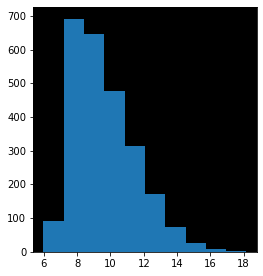

In [36]:
rcParams['figure.figsize'] = 4, 4.5
# look at the numberof cells per spot factors
plt.hist(adata_vis_res.uns['mod']['post_sample_means']['cells_per_spot']);

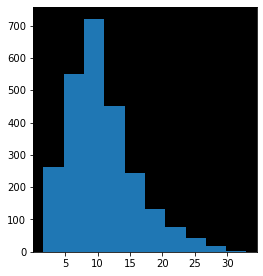

In [37]:
# look at the numberof expressed factors
plt.hist(spot_factors.sum(1));

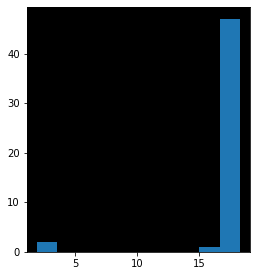

In [38]:
# look at the number of expressed factors
plt.hist(adata_vis_res.uns['mod']['post_sample_means']['factors_per_combs']);

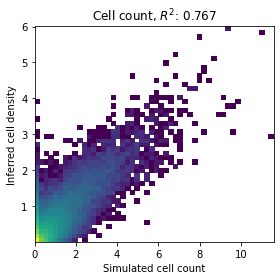

In [39]:
rcParams['figure.figsize'] = 4, 4
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_count.values.flatten(), 
           infer_cell_count.values.flatten(),# / np.mean(adata_vis_res.var['gene_level'].values),
           bins=[50, 50], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell count');
plt.ylabel('Inferred cell density');
plt.title(r'Cell count, $R^2$: ' \
          + str(np.round(np.corrcoef(cell_count.values.flatten(), 
           infer_cell_count.values.flatten()), 3)[0,1]));
#plt.gca().set_aspect('equal', adjustable='box')
plt.tight_layout()
plt.savefig(fig_path + '/Cell_density_cor.pdf')

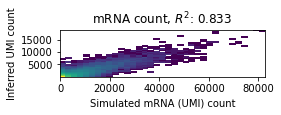

In [40]:
rcParams['figure.figsize'] = 4, 4.5
rcParams["axes.facecolor"] = "white"

plt.hist2d(umi_count.values.flatten(), 
           nUMI_factors.values.flatten() \
           / np.mean(adata_vis_res.var['gene_level'].values),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated mRNA (UMI) count');
plt.ylabel('Inferred UMI count');
plt.title('mRNA count, $R^2$: ' \
          + str(np.round(np.corrcoef(umi_count.values.flatten(), 
           nUMI_factors.values.flatten()), 3)[0,1]));
plt.gca().set_aspect('equal', adjustable='box')
plt.tight_layout()
plt.savefig(fig_path + '/nUMI_count_cor.pdf')

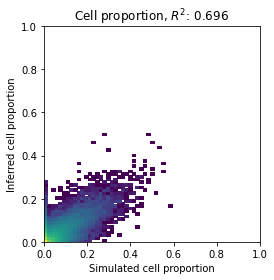

In [41]:
cell_proportions = (cell_count.T / cell_count.sum(1)).T
cell_proportions.iloc[np.isnan(cell_proportions.values)] = 0
infer_cell_proportions = (infer_cell_count.T / infer_cell_count.sum(1)).T

rcParams['figure.figsize'] = 4, 4
plt.hist2d(cell_proportions.values.flatten(), 
           infer_cell_proportions.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportion');
plt.ylabel('Inferred cell proportion');
plt.title('Cell proportion, $R^2$: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           infer_cell_proportions.values.flatten()), 3)[0,1]));
plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.tight_layout()
plt.savefig(fig_path + '/Cell_proportion_cor.pdf')

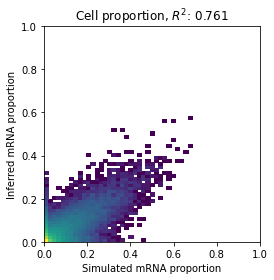

In [42]:
umi_count_proportions = (umi_count.T / umi_count.sum(1)).T
umi_count_proportions.iloc[np.isnan(umi_count_proportions.values)] = 0
infer_nUMI_factors = (nUMI_factors.T / nUMI_factors.sum(1)).T

rcParams['figure.figsize'] = 4, 4
plt.hist2d(umi_count_proportions.values.flatten(), 
           infer_nUMI_factors.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated mRNA proportion');
plt.ylabel('Inferred mRNA proportion');
plt.title('Cell proportion, $R^2$: ' \
          + str(np.round(np.corrcoef(umi_count_proportions.values.flatten(), 
           infer_nUMI_factors.values.flatten()), 3)[0,1]));
plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.tight_layout()
plt.savefig(fig_path + '/mRNA_proportion_cor.pdf')

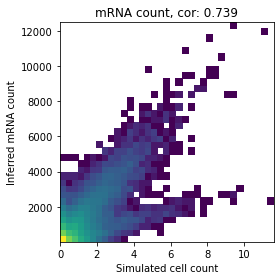

In [43]:
rcParams['figure.figsize'] = 4, 4
plt.hist2d(cell_count.values.flatten(), 
           infer_nUMI_count.values.flatten(),
           bins=35, norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell count');
plt.ylabel('Inferred mRNA count');
plt.title('mRNA count, cor: ' \
          + str(np.round(np.corrcoef(cell_count.values.flatten(), 
           infer_nUMI_count.values.flatten()), 3)[0,1]));
plt.tight_layout();
#plt.savefig(fig_path + '/mRNA_count_cor.pdf')

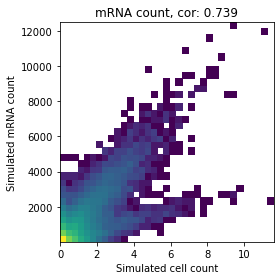

In [44]:
rcParams['figure.figsize'] = 4, 4
plt.hist2d(cell_count.values.flatten(), 
           nUMI_factors.values.flatten(),
           bins=35, norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell count');
plt.ylabel('Simulated mRNA count');
plt.title('mRNA count, cor: ' \
          + str(np.round(np.corrcoef(cell_count.values.flatten(), 
           infer_nUMI_count.values.flatten()), 3)[0,1]));
plt.tight_layout();
#plt.savefig(fig_path + '/mRNA_count_cor.pdf')

In [45]:
import matplotlib as mpl
from matplotlib import pyplot as plt
import numpy as np
from scipy import interpolate

with plt.style.context('seaborn'):
    seaborn_colors = mpl.rcParams['axes.prop_cycle'].by_key()['color']


def compute_precision_recall(pos_cell_count, infer_cell_proportions, mode='macro'):
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    """
    
    from sklearn.metrics import precision_recall_curve
    from sklearn.metrics import average_precision_score
    
    ### calculating ###
    predictor = infer_cell_proportions.values + np.random.gamma(20, 1e-12, 
                                                                infer_cell_proportions.shape)
    # For each cell type
    precision = dict()
    recall = dict()
    average_precision = dict()
    for i, c in enumerate(infer_cell_proportions.columns):
        precision[c], recall[c], _ = precision_recall_curve(pos_cell_count[:, i],
                                                            predictor[:, i])
        average_precision[c] = average_precision_score(pos_cell_count[:, i], predictor[:, i], average=mode)

    average_precision["averaged"] = average_precision_score(pos_cell_count, predictor,
                                                     average=mode)

    # A "micro-average": quantifying score on all classes jointly
    if mode == 'micro':
        precision_, recall_, threshold = precision_recall_curve(pos_cell_count.ravel(),
                                                                        predictor.ravel())
        #precision_[threshold < 0.1] = 0
        precision["averaged"], recall["averaged"] =  precision_, recall_

    elif mode == 'macro':
        precisions = []
        recall_grid = np.linspace(0, 1, 2000)

        for i, c in enumerate(infer_cell_proportions.columns):
            f = interpolate.interp1d(recall[c], precision[c])
            precision_interp = f(recall_grid)
            precisions.append(precision_interp)

        precision["averaged"] = np.mean(precisions, axis=0)
        recall['averaged'] = recall_grid

        
    return precision, recall, average_precision

def compute_roc(pos_cell_count, infer_cell_proportions, mode='macro'):
    r""" Plot ROC curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    """
    
    from sklearn.metrics import roc_curve
    from sklearn.metrics import roc_auc_score
    
    ### calculating ###
    predictor = infer_cell_proportions.values + np.random.gamma(20, 1e-12, 
                                                                infer_cell_proportions.shape)
    # For each cell type
    precision = dict()
    recall = dict()
    average_precision = dict()
    for i, c in enumerate(infer_cell_proportions.columns):
        precision[c], recall[c], _ = roc_curve(pos_cell_count[:, i],
                                                            predictor[:, i])
        average_precision[c] = roc_auc_score(pos_cell_count[:, i], predictor[:, i], average=mode)

    average_precision["averaged"] = roc_auc_score(pos_cell_count, predictor,
                                                     average=mode)

    # A "micro-average": quantifying score on all classes jointly
    if mode == 'micro':
        precision_, recall_, threshold = roc_curve(pos_cell_count.ravel(),
                                                                        predictor.ravel())
        #precision_[threshold < 0.1] = 0
        precision["averaged"], recall["averaged"] =  precision_, recall_

    elif mode == 'macro':
        precisions = []
        recall_grid = np.linspace(0, 1, 2000)

        for i, c in enumerate(infer_cell_proportions.columns):
            f = interpolate.interp1d(recall[c], precision[c])
            precision_interp = f(recall_grid)
            precisions.append(precision_interp)

        precision["averaged"] = np.mean(precisions, axis=0)
        recall['averaged'] = recall_grid

        
    return precision, recall, average_precision

def plot_precision_recall(pos_cell_count, infer_cell_proportions,
                          title='', iso_f1_curves=False,
                          individual_cell_types=True,
                          save=None, mode='macro', curve='PR'):
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells)
    :param title: plot title
    :param iso_f1_curves: plot iso curves for F1 score?
    :param individual_cell_types: show precision-recall curves for each cell type?
    """
    
    ### calculating ###
    if curve == 'PR':
        precision, recall, average_precision = compute_precision_recall(pos_cell_count, 
                                                                        infer_cell_proportions, 
                                                                        mode=mode)
        xlabel = 'Recall'
        ylabel = 'Precision'
        
    elif curve == 'ROC':
        recall, precision, average_precision = compute_roc(pos_cell_count, 
                                                                        infer_cell_proportions, 
                                                                        mode=mode)
        xlabel = 'FPR'
        ylabel = 'TPR'
        
    ### plotting ###
    from itertools import cycle
    # setup plot details
    colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])

    lines = []
    labels = []
    
    if iso_f1_curves:
        f_scores = np.linspace(0.2, 0.8, num=4)
        
        for f_score in f_scores:
            x = np.linspace(0.01, 1)
            y = f_score * x / (2 * x - f_score)
            l, = plt.plot(x[y >= 0], y[y >= 0], color='gray', alpha=0.2)
            plt.annotate('f1={0:0.1f}'.format(f_score), xy=(0.9, y[45] + 0.02))

        lines.append(l)
        labels.append('iso-f1 curves')
    
    l, = plt.plot(recall["averaged"], precision["averaged"], color='navy', lw=2)
    lines.append(l)
    labels.append(f'{mode}-average {curve} ({curve} score = {round(average_precision["averaged"], 2)})')

    if individual_cell_types:
        for i, color in zip(infer_cell_proportions.columns, colors):
            l, = plt.plot(recall[i], precision[i], color='gold', lw=1)
            lines.append(l)
        labels.append(f'{curve} for individual cell types')



    fig = plt.gcf()
    fig.subplots_adjust(bottom=0.25)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.legend(lines, labels, loc=(0, -.37), prop=dict(size=8))
    
    if save is not None:
        plt.savefig(save)

def compare_precision_recall(pos_cell_count, infer_cell_proportions,
                             method_title, title='',
                             legend_loc=(0, -.37),
                             colors=sc.pl.palettes.default_102,
                             mode='macro', curve='PR'):
    
    r""" Plot precision-recall curves on average and for each cell type.
    :param pos_cell_count: binary matrix showing which cell types are present in which locations
    :param infer_cell_proportions: inferred locations (the higher the more cells), 
                                        list of inferred parameters for several methods
    :param method_title: title for each infer_cell_proportions
    :param title: plot title
    """
    # setup plot details
    from itertools import cycle
    colors = cycle(colors)
    lines = []
    labels = []
    roc = {}
    
    ### plotting ###
    for i, color in zip(range(len(infer_cell_proportions)), colors):
        
        if curve == 'PR':
            precision, recall, average_precision = compute_precision_recall(pos_cell_count, 
                                                                        infer_cell_proportions[i], 
                                                                        mode=mode)

            xlabel = 'Recall'
            ylabel = 'Precision'
            
            l, = plt.plot(recall["averaged"], precision["averaged"], color=color, lw=3)

        elif curve == 'ROC':
            FPR, TPR, average_precision = compute_roc(pos_cell_count, 
                                                                        infer_cell_proportions[i], 
                                                                        mode=mode)

            xlabel = 'FPR'
            ylabel = 'TPR'
            
            l, = plt.plot(FPR["averaged"], TPR["averaged"], color=color, lw=3)
            
        
        lines.append(l)

        labels.append(method_title[i] + '(' + curve + ' score = {0:0.2f})'
                      ''.format(average_precision["averaged"]))
        roc[method_title[i]] = average_precision["averaged"]


    fig = plt.gcf()
    fig.subplots_adjust(bottom=0.25)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    if legend_loc is not None:
        plt.legend(lines, labels, loc=legend_loc, prop=dict(size=14))

    #plt.show()
    return roc


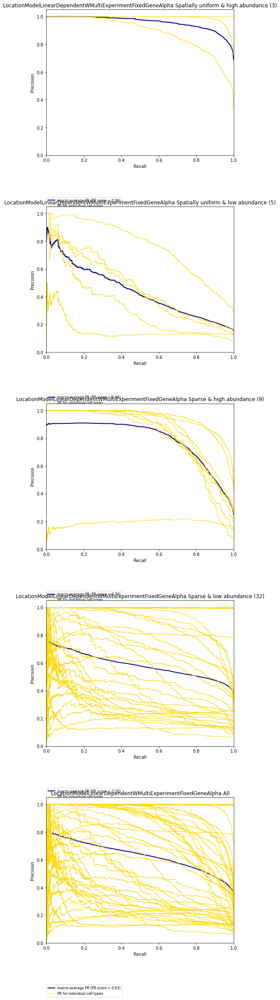

In [46]:
rcParams['figure.figsize'] = 7, 32
rcParams['pdf.fonttype'] = 42
pos_cell_count = cell_count.values > 0.1

def pr_by_category(pos_cell_count, infer_cell_count, design,
                   nrow=5, ncol=1, title='', fig_path=''):

    design_loc = design.loc[cell_count.columns,:]
    
    plt.subplot(nrow, ncol, 1)
    ind = (design_loc['is_uniform'] * design_loc['is_high_density']).values.astype(bool)
    plot_precision_recall(pos_cell_count[:, ind], infer_cell_count.loc[:,ind],
                          title=f'{title} Spatially uniform & high abundance ({ind.sum()})',
                          #save=fig_path + '/Uniform_low_abundance.pdf'
                         )
    
    plt.subplot(nrow, ncol, 2)
    ind = (design_loc['is_uniform'] * (1 - design_loc['is_high_density'])).values.astype(bool)
    plot_precision_recall(pos_cell_count[:, ind], infer_cell_count.loc[:,ind],
                          title=f'{title} Spatially uniform & low abundance ({ind.sum()})',
                          #save=fig_path + '/Uniform_high_abundance.pdf'
                         )
    
    plt.subplot(nrow, ncol, 3)
    ind = ((1 - design_loc['is_uniform']) * design_loc['is_high_density']).values.astype(bool)
    plot_precision_recall(pos_cell_count[:, ind], infer_cell_count.loc[:,ind],
                          title=f'{title} Sparse & high abundance ({ind.sum()})',
                          #save=fig_path + '/Segregated_low_abundance.pdf'
                         )
    
    plt.subplot(nrow, ncol, 4)
    ind = ((1 - design_loc['is_uniform']) * (1 - design_loc['is_high_density'])).values.astype(bool)
    plot_precision_recall(pos_cell_count[:, ind], infer_cell_count.loc[:,ind],
                          title=f'{title} Sparse & low abundance ({ind.sum()})',
                          #save=fig_path + '/Segregated_high_abundance.pdf'
                         )
    
    plt.subplot(nrow, ncol, 5)
    plot_precision_recall(pos_cell_count, infer_cell_count,
                          title=title + ' All',
                          #save=fig_path + '/All.pdf'
                         )
    
from re import sub
model_name = sub('_.+$', '', r['run_name'])
pr_by_category(pos_cell_count, infer_cell_count, adata_vis_res.uns['design']['cell_types2zones'],
               nrow=5, ncol=1, title=model_name,#r['model_name'],#.__name__,
               fig_path=fig_path)
plt.tight_layout()
plt.savefig(fig_path + '/All.pdf')

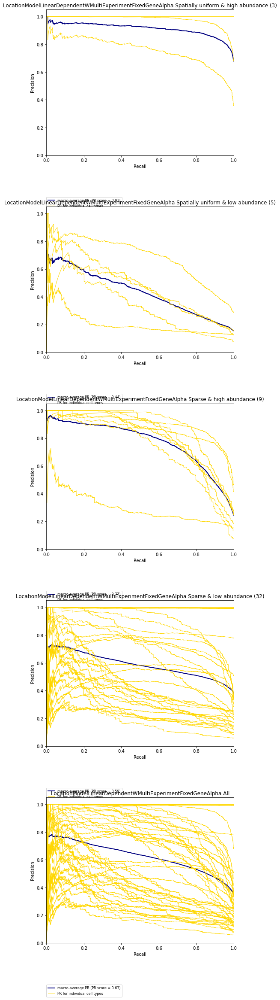

In [48]:
rcParams['figure.figsize'] = 7, 32
rcParams['pdf.fonttype'] = 42
pos_cell_count = cell_count.values > 0.1

pr_by_category(pos_cell_count, infer_cell_proportions, adata_vis_res.uns['design']['cell_types2zones'],
               nrow=5, ncol=1, title=model_name,# r['model_name'],#.__name__,
               fig_path=fig_path)
plt.tight_layout()

#### Split results by spatial distribution and abundance of cell types

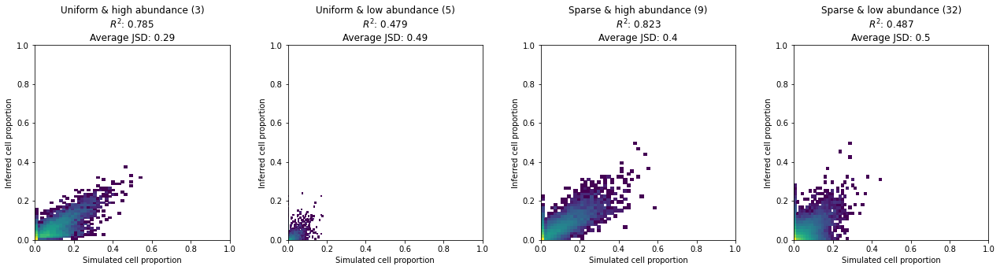

In [49]:
def KL(a, b):
    a = np.asarray(a, dtype=np.float)
    b = np.asarray(b, dtype=np.float)

    return np.sum(np.where(a != 0, a * np.log2(a / b), 0))
from scipy.spatial.distance import jensenshannon

def hist_obs_sim(cell_count, infer_cell_count,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 title='', compute_kl=True, equal=True, max_val=1):
    
    cor = np.round(np.corrcoef(cell_count.values.flatten(), 
               infer_cell_count.values.flatten()), 3)[0,1]
    title = title +'\n'+ r'$R^2$: ' + str(cor)
    
    if compute_kl:
        
        #kl = [KL(cell_count.values[r,:], infer_cell_count.values[r,:]) 
        #         for r in range(cell_count.shape[0])]
        js = np.array([jensenshannon(cell_count.values[r,:], infer_cell_count.values[r,:]) 
                 for r in range(cell_count.shape[0])])
        #kl = np.mean(kl)
        js = np.mean(js[~np.isnan(js)])
        #title = title + '\nAverage KL: ' + str(np.round(kl, 2))
        title = title + '\nAverage JSD: ' + str(np.round(js, 2))
    
    plt.hist2d(cell_count.values.flatten(), 
               infer_cell_count.values.flatten(),
               bins=[35, 35], norm=matplotlib.colors.LogNorm());
    plt.xlabel(xlab);
    plt.ylabel(ylab);
    if equal:
        plt.gca().set_aspect('equal', adjustable='box')
    plt.xlim(0, max_val);
    plt.ylim(0, max_val);
    plt.title(title);
    
def hist_by_category(cell_count, infer_cell_count, design,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 nrow=1, ncol=4, compute_kl=True, equal=True):

    design_loc = design.loc[cell_count.columns,:]
    
    max_val = np.array([cell_count.values.max(), infer_cell_count.values.max()]).max()
    if max_val < 1:
        max_val = 1
    
    plt.subplot(nrow, ncol, 1)
    ind = (design_loc['is_uniform'] * design_loc['is_high_density']).values.astype(bool)
    hist_obs_sim(cell_count.loc[:,ind], infer_cell_count.loc[:,ind],
                 xlab=xlab,
                 ylab=ylab,
                 title=f'Uniform & high abundance ({ind.sum()})',
                 compute_kl=compute_kl, equal=equal, max_val=max_val)
    
    plt.subplot(nrow, ncol, 2)
    ind = (design_loc['is_uniform'] * (1 - design_loc['is_high_density'])).values.astype(bool)
    hist_obs_sim(cell_count.loc[:,ind], infer_cell_count.loc[:,ind],
                 xlab=xlab,
                 ylab=ylab,
                 title=f'Uniform & low abundance ({ind.sum()})',
                 compute_kl=compute_kl, equal=equal, max_val=max_val)
    
    plt.subplot(nrow, ncol, 3)
    ind = ((1 - design_loc['is_uniform']) * design_loc['is_high_density']).values.astype(bool)
    hist_obs_sim(cell_count.loc[:,ind], infer_cell_count.loc[:,ind],
                 xlab=xlab,
                 ylab=ylab,
                 title=f'Sparse & high abundance ({ind.sum()})',
                 compute_kl=compute_kl, equal=equal, max_val=max_val)
    
    plt.subplot(nrow, ncol, 4)
    ind = ((1 - design_loc['is_uniform']) * (1 - design_loc['is_high_density'])).values.astype(bool)
    hist_obs_sim(cell_count.loc[:,ind], infer_cell_count.loc[:,ind],
                 xlab=xlab,
                 ylab=ylab,
                 title=f'Sparse & low abundance ({ind.sum()})',
                 compute_kl=compute_kl, equal=equal, max_val=max_val)
    
cell_proportions = (cell_count.T / cell_count.sum(1)).T
cell_proportions.iloc[np.isnan(cell_proportions.values)] = 0
infer_cell_proportions = (infer_cell_count.T / infer_cell_count.sum(1)).T

rcParams['figure.figsize'] = 18,4.5 #9,9 #20, 4.5
rcParams["axes.facecolor"] = "white"
hist_by_category(cell_proportions, infer_cell_proportions, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 #compute_kl=False, 
                 nrow=1, ncol=4, equal=True)
plt.tight_layout()

plt.savefig(fig_path + '/hist_by_category.pdf')

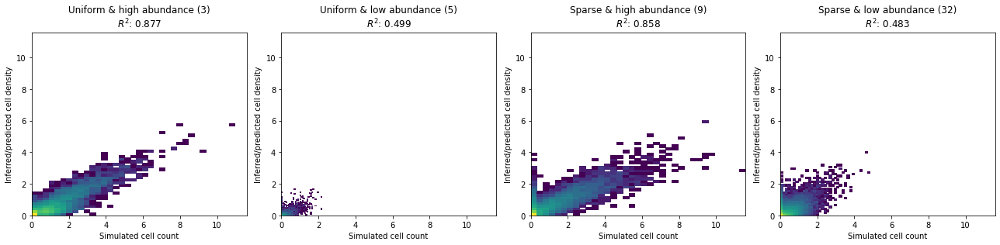

In [50]:
rcParams['figure.figsize'] = 18, 4.5
rcParams["axes.facecolor"] = "white"
hist_by_category(cell_count, infer_cell_count, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell count',
                 ylab='Inferred/predicted cell density',
                 compute_kl=False, equal=False)
plt.tight_layout()
plt.savefig(fig_path + '/hist_density_by_category.pdf')

plt.hist(adata_vis_res.uns['mod']['post_sample_means']['factors_per_spot'].flatten());

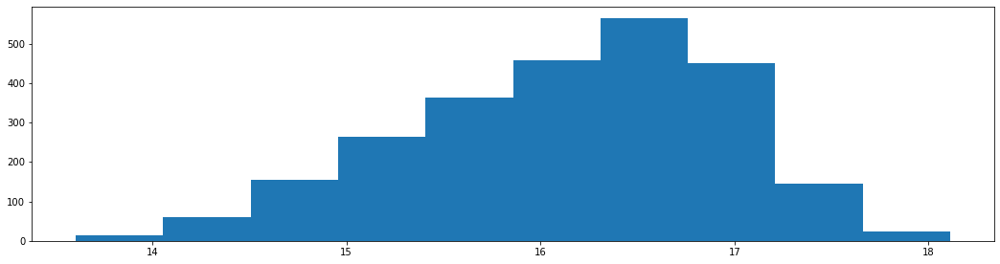

In [51]:
plt.hist(adata_vis_res.uns['mod']['post_sample_means']['combs_per_spot'].flatten());

In [52]:
combs_factors_df = pd.DataFrame(adata_vis_res.uns['mod']['post_sample_means']['combs_factors'],
                            columns=['comb_' + str(i) for i in range(adata_vis_res.uns['mod']['post_sample_means']['combs_factors'].shape[1])])
combs_factors_df

,comb_0,comb_1,comb_2,comb_3,comb_4,comb_5,comb_6,comb_7,comb_8,comb_9,...,comb_40,comb_41,comb_42,comb_43,comb_44,comb_45,comb_46,comb_47,comb_48,comb_49
0,0.196407,0.213359,0.181119,0.244122,0.249025,0.203177,0.218494,0.178139,0.237390,0.196845,...,0.200068,0.182283,0.208747,0.208868,0.192636,0.145250,0.196878,0.216390,0.212290,0.206446
1,0.157182,0.152934,0.152597,0.114348,0.201954,0.170498,0.167711,0.167994,0.198900,0.263211,...,0.140117,0.164487,0.187418,0.168893,0.183548,0.198380,0.141903,0.143783,0.120254,0.145085
2,0.164653,0.208131,0.165006,0.150360,0.141177,0.162405,0.145392,0.225428,0.190336,0.189086,...,0.171152,0.218302,0.194522,0.170998,0.171759,0.202898,0.166447,0.172312,0.181477,0.129730
3,0.294366,0.186318,0.258855,0.242781,0.254941,0.197145,0.186619,0.222135,0.404479,0.302037,...,0.214499,0.320768,0.304377,0.224543,0.187327,0.314636,0.266103,0.218600,0.236673,0.219571
4,0.277731,0.208037,0.193808,0.188412,0.192137,0.224050,0.189697,0.334670,0.234730,0.294420,...,0.191957,0.276079,0.170010,0.217718,0.284802,0.365363,0.216492,0.303772,0.284332,0.168559
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2495,0.236250,0.224181,0.180268,0.220756,0.197196,0.171873,0.242292,0.208517,0.253654,0.273493,...,0.213415,0.227617,0.287756,0.240374,0.194655,0.245882,0.180797,0.254459,0.281239,0.186584
2496,0.169006,0.197601,0.145500,0.155859,0.145087,0.126760,0.156766,0.177349,0.128236,0.144295,...,0.174088,0.134032,0.148335,0.145189,0.171436,0.151847,0.135479,0.171044,0.173175,0.127836
2497,0.259847,0.217098,0.338768,0.291175,0.177007,0.183190,0.218492,0.173740,0.221491,0.165591,...,0.202173,0.243817,0.179559,0.203040,0.218206,0.210342,0.248509,0.274807,0.179707,0.210675
2498,0.275916,0.227644,0.350519,0.308052,0.268116,0.221407,0.255532,0.273719,0.184235,0.319815,...,0.311437,0.299277,0.352845,0.314361,0.239869,0.303240,0.292298,0.229684,0.233297,0.251717


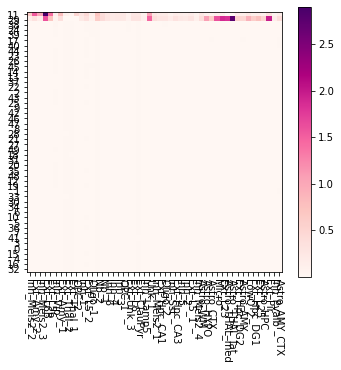

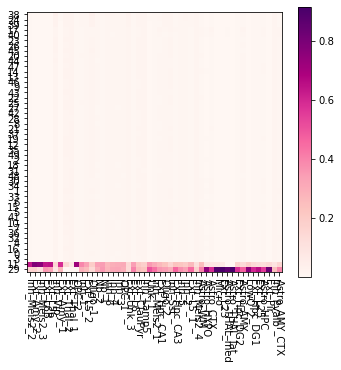

In [53]:
from cell2location.plt.plot_heatmap import clustermap
comb2fact_df = pd.DataFrame(adata_vis_res.uns['mod']['post_sample_means']['comb2fact'],
                            columns=adata_vis_res.uns['mod']['fact_names'])
comb2fact_df_prop = (comb2fact_df / comb2fact_df.sum(0))
clustermap(comb2fact_df)
clustermap(comb2fact_df_prop)

#### Stratify cell types by their size in the reference

In [54]:
gene_factors = pd.DataFrame(adata_vis_res.uns['mod']['post_sample_means']['gene_factors'],
                            index=adata_vis_res.uns['mod']['var_names'],
                            columns=adata_vis_res.uns['mod']['fact_names'])

Index(['Astro_AMY_CTX', 'Astro_THAL_lat', 'Astro_WM', 'Oligo_2'], dtype='object')

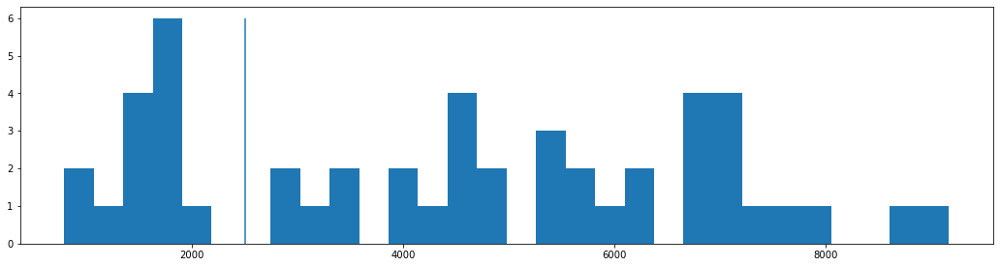

In [55]:
plt.hist(gene_factors.sum(0), bins=30);
plt.vlines(2500, 0, 6);
small_ind = np.array(gene_factors.sum(0) < 2500) \
& (adata_vis_res.uns['design']['cell_types2zones']['is_high_density']).values.astype(bool)
gene_factors.columns[small_ind]

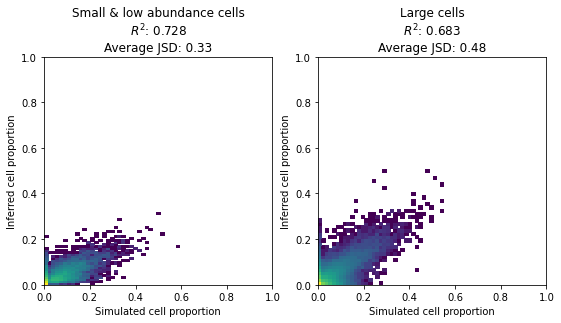

In [56]:
def hist_by_category2(cell_count, infer_cell_count, index,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='', name2='',
                 nrow=1, ncol=4, compute_kl=True, equal=True):

    design_loc = adata_vis_res.uns['design']['cell_types2zones'].loc[cell_count.columns,:]
    
    plt.subplot(nrow, ncol, 1)
    hist_obs_sim(cell_count.loc[:,index], infer_cell_count.loc[:,index.astype(bool)],
                 xlab=xlab,
                 ylab=ylab,
                 title=name1,
                 compute_kl=compute_kl, equal=equal)
    
    plt.subplot(nrow, ncol, 2)
    hist_obs_sim(cell_count.loc[:,~index], infer_cell_count.loc[:,~index.astype(bool)],
                 xlab=xlab,
                 ylab=ylab,
                 title=name2,
                 compute_kl=compute_kl, equal=equal)
    
rcParams['figure.figsize'] = 9, 4.5
rcParams["axes.facecolor"] = "white"

hist_by_category2(cell_proportions, infer_cell_proportions, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

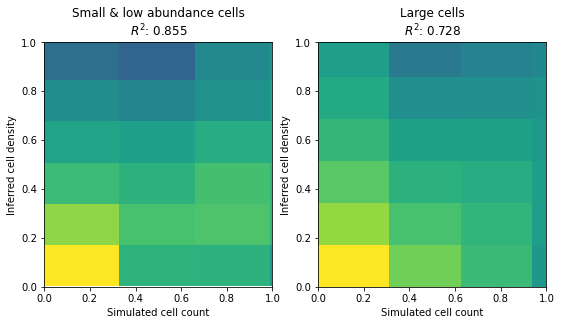

In [57]:
hist_by_category2(cell_count, infer_cell_count, small_ind,
                 xlab='Simulated cell count',
                 ylab='Inferred cell density',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=False, equal=False)

### Evaluate inferred gene expression level difference between technologies (`gene_level`)

In [58]:
gene_level = pd.DataFrame(adata_vis_res.uns['mod']['post_sample_means']['gene_level'].flatten(),
                 index=adata_vis_res.uns['mod']['var_names'],
                 columns=['inferred_gene_level'])
adata_vis_res.var['inferred_gene_level'] = gene_level.reindex(index=adata_vis_res.var_names)['inferred_gene_level']

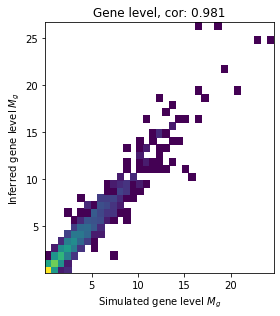

In [59]:
rcParams['figure.figsize'] = 4, 4.5
var = adata_vis_res.var
var = var.loc[~var['inferred_gene_level'].isna(),:]
plt.hist2d(var['gene_level'].values.flatten(), 
           var['inferred_gene_level'].values.flatten(),
           bins=35, norm=matplotlib.colors.LogNorm());
plt.xlabel(r'Simulated gene level $M_g$');
plt.ylabel('Inferred gene level $M_g$');
#plt.xlim(0, 1);
#plt.ylim(0, 1);
plt.title('Gene level, cor: ' \
          + str(np.round(np.corrcoef(var['gene_level'].values.flatten(), 
                var['inferred_gene_level'].values.flatten()), 3)[0,1]));
plt.tight_layout();
plt.savefig(fig_path + '/hist_gene_level.pdf')

### Evaluate inferred cell density inferred with stereoscope

In [55]:
stereo_path_1 = f'{results_folder}scvi_stereoscope/'
scvi_stereoscope = anndata.read(f'{stereo_path_1}sp_n_epochs30k.h5ad')

scvi_stereoscope = scvi_stereoscope.obsm['decomposition'].copy()
scvi_stereoscope = (scvi_stereoscope.T / scvi_stereoscope.sum(1)).T
scvi_stereoscope = scvi_stereoscope.loc[cell_count.index,:]

In [56]:
stereo_df = scvi_stereoscope[cell_count.columns]

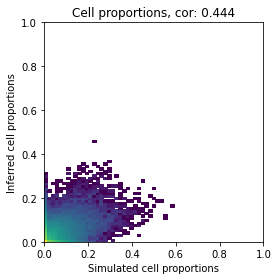

In [57]:
rcParams['figure.figsize'] = 4, 4
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_proportions.values.flatten(), 
           stereo_df.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportions');
plt.ylabel('Inferred cell proportions');
plt.title('Cell proportions, cor: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           stereo_df.values.flatten()), 3)[0,1]));
plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.tight_layout();

plt.savefig(os.path.split(stereo_path_1)[0] + '/Cell_proportion_cor.pdf')

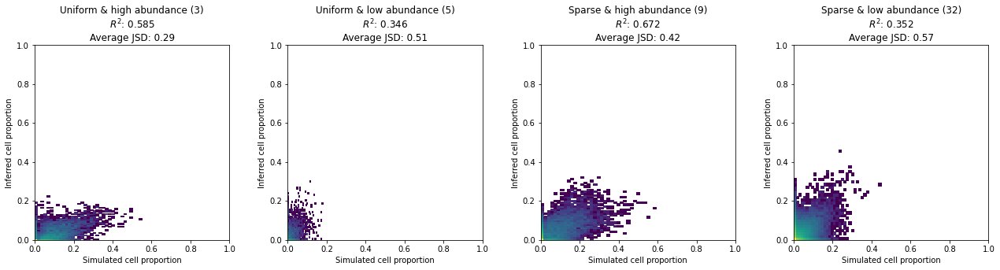

In [58]:
rcParams['figure.figsize'] = 18, 4.5
hist_by_category(cell_proportions, stereo_df, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion')
plt.tight_layout()

plt.savefig(os.path.split(stereo_path_1)[0] + '/Cell_proportion_cor_by_group.pdf')

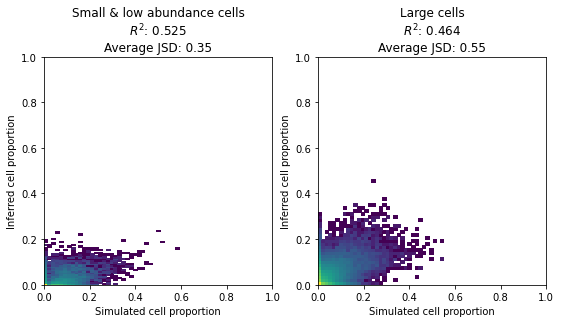

In [59]:
rcParams['figure.figsize'] = 9, 4.5
hist_by_category2(cell_proportions, stereo_df, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

plt.savefig(os.path.split(stereo_path_1)[0] + '/Cell_proportion_cor_by_size.pdf')

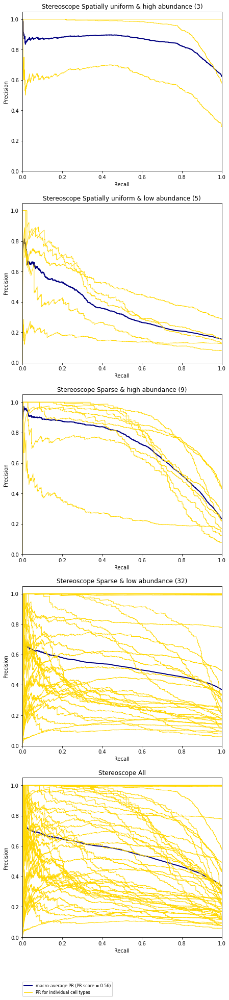

In [60]:
rcParams['figure.figsize'] = 7, 40
pos_cell_count = cell_count.values > 0.1
pr_by_category(pos_cell_count, stereo_df, adata_vis_res.uns['design']['cell_types2zones'],
                 nrow=5, ncol=1,
                      title='Stereoscope')

plt.savefig(os.path.split(stereo_path_1)[0] + '/ROC_all.pdf')

### Evaluate inferred cell density inferred with nnls (autogenes)

In [61]:
# read cell proportions
nnls_path_1 = results_folder + 'autogenes_models/coef_nnls_seed.csv'
nnls_df = pd.read_csv(nnls_path_1, sep=',', index_col=0).T

# compute proportions per location
nnls_df = (nnls_df.T / nnls_df.sum(1)).T

adata_vis_plt = adata_vis.copy()
nnls_df = nnls_df.loc[nnls_df.index.isin(adata_vis_plt.obs_names)]
adata_vis_plt = adata_vis_plt[nnls_df.index,:]

adata_vis_plt.obs['imagecol'] = adata_vis_plt.obsm['X_spatial'][:,0]
adata_vis_plt.obs['imagerow'] = - adata_vis_plt.obsm['X_spatial'][:,1]

Trying to set attribute `.obs` of view, copying.


In [62]:
nnls_df = nnls_df[cell_count.columns]

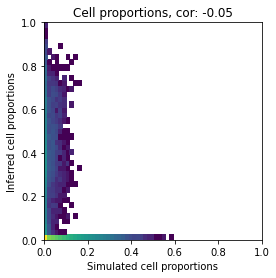

In [63]:
rcParams['figure.figsize'] = 4, 4
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_proportions.values.flatten(), 
           nnls_df.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportions');
plt.ylabel('Inferred cell proportions');
plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.title('Cell proportions, cor: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           nnls_df.values.flatten()), 3)[0,1]));

plt.savefig(os.path.split(nnls_path_1)[0] + '/Cell_proportion_cor.pdf')

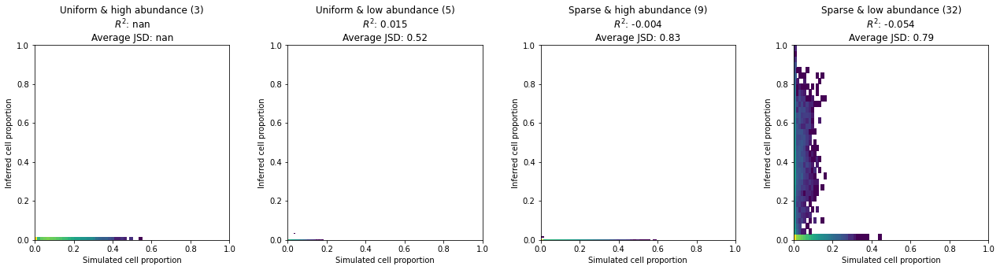

In [64]:
rcParams['figure.figsize'] = 18, 4.5
hist_by_category(cell_proportions, nnls_df, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion')
plt.tight_layout()

plt.savefig(os.path.split(nnls_path_1)[0] + '/Cell_proportion_cor_by_group.pdf')

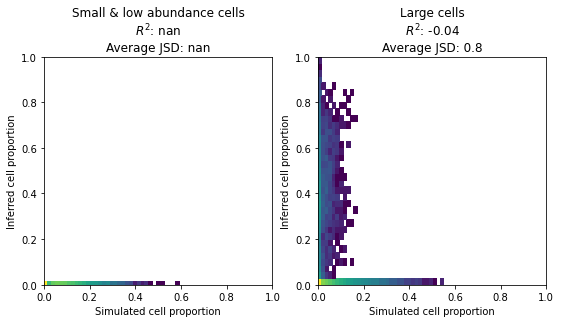

In [65]:
rcParams['figure.figsize'] = 9, 4.5
hist_by_category2(cell_proportions, nnls_df, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

plt.savefig(os.path.split(nnls_path_1)[0] + '/Cell_proportion_cor_by_size.pdf')

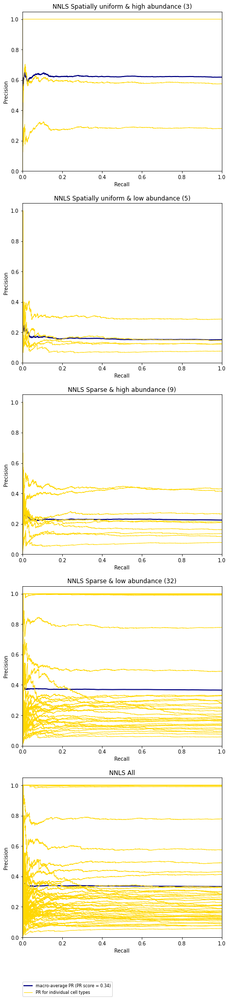

In [66]:
rcParams['figure.figsize'] = 7, 40
pos_cell_count = cell_count.values > 0.1
pr_by_category(pos_cell_count, nnls_df, adata_vis_res.uns['design']['cell_types2zones'],
                 nrow=5, ncol=1,
                      title='NNLS')

plt.savefig(os.path.split(nnls_path_1)[0] + '/ROC_all.pdf')

### Evaluate inferred cell density inferred with RCTD

In [67]:
# read cell proportions
RCTD_path_1 = results_folder + 'rctd/results_weights.csv'
RCTD_df = pd.read_csv(RCTD_path_1, sep=',', index_col='spot')

# compute proportions per location
RCTD_df_orig = RCTD_df.copy()
RCTD_df = (RCTD_df.T / RCTD_df.sum(1)).T

adata_vis_plt = adata_vis.copy()
RCTD_df = RCTD_df.loc[RCTD_df.index.isin(adata_vis_plt.obs_names)]
adata_vis_plt = adata_vis_plt[RCTD_df.index,:]

adata_vis_plt.obs['imagecol'] = adata_vis_plt.obsm['X_spatial'][:,0]
adata_vis_plt.obs['imagerow'] = - adata_vis_plt.obsm['X_spatial'][:,1]

Trying to set attribute `.obs` of view, copying.


In [68]:
RCTD_df = RCTD_df[cell_count.columns]
RCTD_df_orig = RCTD_df_orig[cell_count.columns]

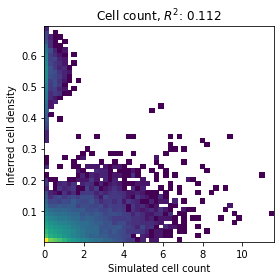

In [69]:
rcParams['figure.figsize'] = 4, 4
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_count.values.flatten(), 
           RCTD_df_orig.values.flatten(),# / np.mean(adata_vis_res.var['gene_level'].values),
           bins=[50, 50], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell count');
plt.ylabel('Inferred cell density');
plt.title(r'Cell count, $R^2$: ' \
          + str(np.round(np.corrcoef(cell_count.values.flatten(), 
           RCTD_df_orig.values.flatten()), 3)[0,1]));
#plt.gca().set_aspect('equal', adjustable='box')
plt.tight_layout()
plt.savefig(os.path.split(RCTD_path_1)[0] + '/RCTD_Cell_density_cor.pdf')

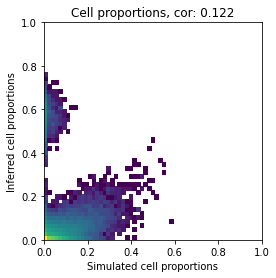

In [70]:
rcParams['figure.figsize'] = 4, 4
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_proportions.values.flatten(), 
           RCTD_df.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportions');
plt.ylabel('Inferred cell proportions');
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Cell proportions, cor: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           RCTD_df.values.flatten()), 3)[0,1]));

plt.savefig(os.path.split(RCTD_path_1)[0] + '/Cell_proportion_cor.pdf')

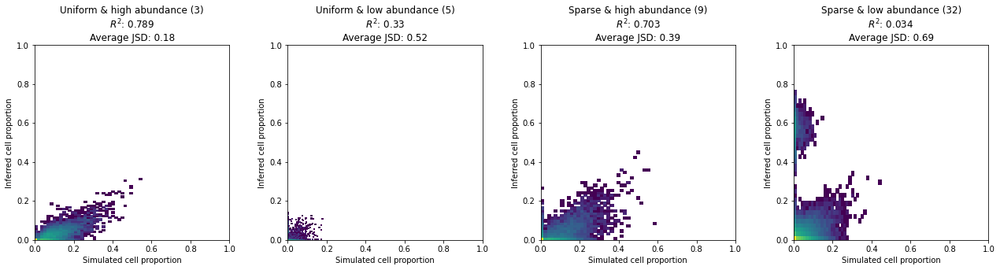

In [71]:
rcParams['figure.figsize'] = 18, 4.5
hist_by_category(cell_proportions, RCTD_df, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion')
plt.tight_layout()

plt.savefig(os.path.split(RCTD_path_1)[0] + '/Cell_proportion_cor_by_group.pdf')

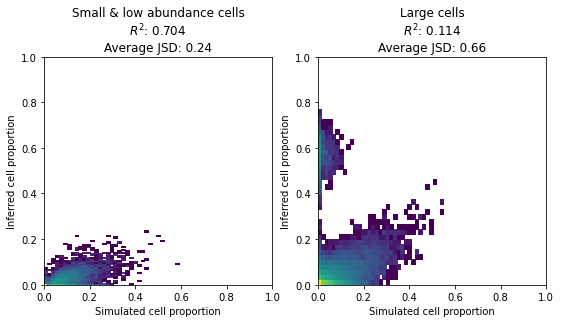

In [72]:
rcParams['figure.figsize'] = 9, 4.5
hist_by_category2(cell_proportions, RCTD_df, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

plt.savefig(os.path.split(RCTD_path_1)[0] + '/Cell_proportion_cor_by_size.pdf')

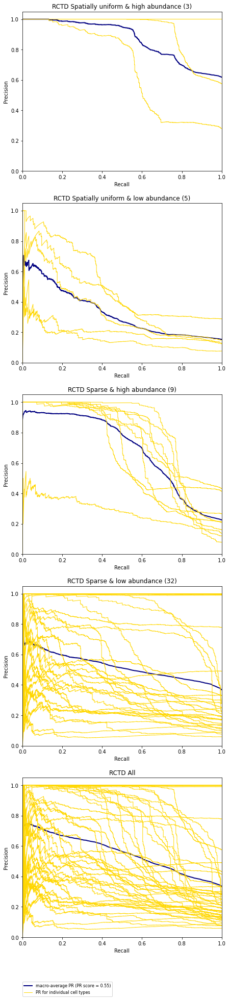

In [73]:
rcParams['figure.figsize'] = 7, 40
pos_cell_count = cell_count.values > 0.1
pr_by_category(pos_cell_count, RCTD_df, adata_vis_res.uns['design']['cell_types2zones'],
                 nrow=5, ncol=1,
                      title='RCTD')

plt.savefig(os.path.split(RCTD_path_1)[0] + '/ROC_all.pdf')

### Evaluate inferred cell propotion inferred with Seurat 3

In [74]:
# read cell proportions
seurat_path_1 = results_folder + 'seurat/results_pca.csv'
seurat_df = pd.read_csv(seurat_path_1, sep=',', index_col='spot')
seurat_df = seurat_df.drop(columns=['predicted.id', 'prediction.score.max', 'Unnamed: 0'])
from re import sub
seurat_df.columns = [sub('prediction.score.', '', i) for i in seurat_df.columns]

# compute proportions per location
seurat_df = (seurat_df.T / seurat_df.sum(1)).T

adata_vis_plt = adata_vis.copy()
seurat_df = seurat_df.loc[seurat_df.index.isin(adata_vis_plt.obs_names)]
adata_vis_plt = adata_vis_plt[seurat_df.index,:]

adata_vis_plt.obs['imagecol'] = adata_vis_plt.obsm['X_spatial'][:,0]
adata_vis_plt.obs['imagerow'] = - adata_vis_plt.obsm['X_spatial'][:,1]

Trying to set attribute `.obs` of view, copying.


In [75]:
seurat_df = seurat_df[cell_count.columns]

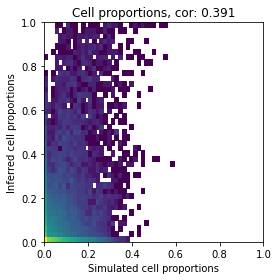

In [76]:
rcParams['figure.figsize'] = 4, 4
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_proportions.values.flatten(), 
           seurat_df.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportions');
plt.ylabel('Inferred cell proportions');
plt.title('Cell proportions, cor: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           seurat_df.values.flatten()), 3)[0,1]));
plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.tight_layout();

plt.savefig(os.path.split(seurat_path_1)[0] + '/Cell_proportion_cor.pdf')

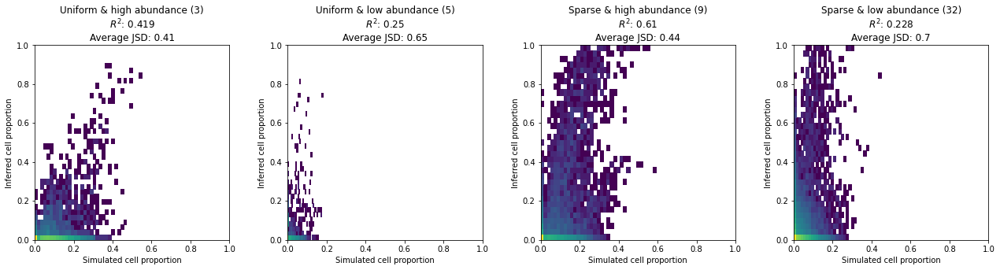

In [77]:
rcParams['figure.figsize'] = 18, 4.5
hist_by_category(cell_proportions, seurat_df, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion')
plt.tight_layout()

plt.savefig(os.path.split(seurat_path_1)[0] + '/Cell_proportion_cor_by_group.pdf')

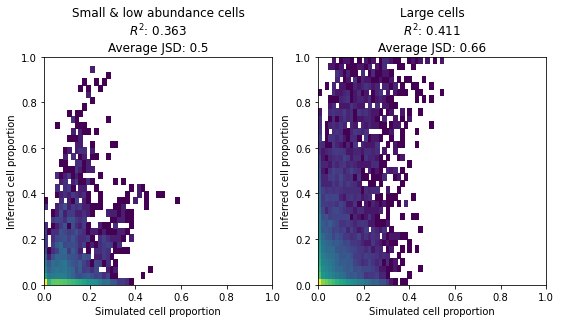

In [78]:
rcParams['figure.figsize'] = 9, 4.5
hist_by_category2(cell_proportions, seurat_df, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

plt.savefig(os.path.split(seurat_path_1)[0] + '/Cell_proportion_cor_by_size.pdf')

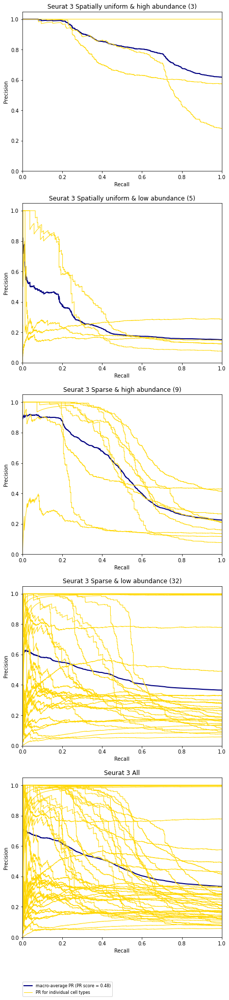

In [79]:
rcParams['figure.figsize'] = 7, 40
pos_cell_count = cell_count.values > 0.1
pr_by_category(pos_cell_count, seurat_df, adata_vis_res.uns['design']['cell_types2zones'],
                 nrow=5, ncol=1,
                      title='Seurat 3',
               fig_path=fig_path)

plt.savefig(os.path.split(seurat_path_1)[0] + '/ROC_all.pdf')

In [80]:
# read cell proportions
seurat_path_1 = results_folder + 'seurat/results_cca.csv'
seurat_cca_df = pd.read_csv(seurat_path_1, sep=',', index_col='spot')
seurat_cca_df = seurat_cca_df.drop(columns=['predicted.id', 'prediction.score.max', 'Unnamed: 0'])
from re import sub
seurat_cca_df.columns = [sub('prediction.score.', '', i) for i in seurat_cca_df.columns]

# compute proportions per location
seurat_cca_df = (seurat_cca_df.T / seurat_cca_df.sum(1)).T

adata_vis_plt = adata_vis.copy()
seurat_cca_df = seurat_cca_df.loc[seurat_cca_df.index.isin(adata_vis_plt.obs_names)]
adata_vis_plt = adata_vis_plt[seurat_cca_df.index,:]

adata_vis_plt.obs['imagecol'] = adata_vis_plt.obsm['X_spatial'][:,0]
adata_vis_plt.obs['imagerow'] = - adata_vis_plt.obsm['X_spatial'][:,1]

Trying to set attribute `.obs` of view, copying.


In [81]:
seurat_cca_df = seurat_cca_df[cell_count.columns]

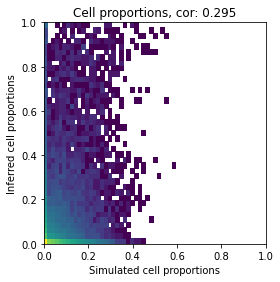

In [82]:
rcParams['figure.figsize'] = 4, 4.5
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_proportions.values.flatten(), 
           seurat_cca_df.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportions');
plt.ylabel('Inferred cell proportions');
plt.title('Cell proportions, cor: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           seurat_cca_df.values.flatten()), 3)[0,1]));
plt.gca().set_aspect('equal', adjustable='box')
plt.xlim(0, 1);
plt.ylim(0, 1);
plt.tight_layout();

plt.savefig(os.path.split(seurat_path_1)[0] + '/cca_Cell_proportion_cor.pdf')

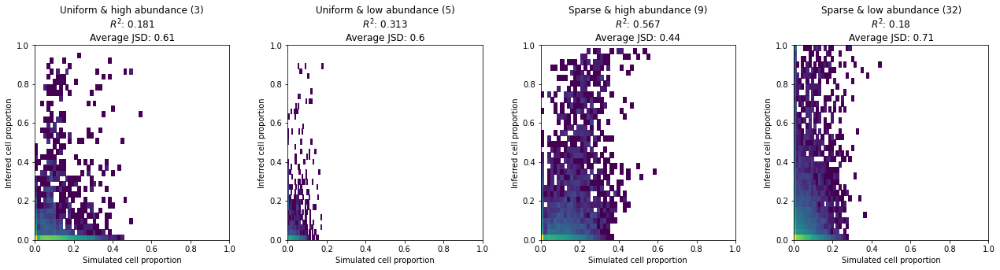

In [83]:
rcParams['figure.figsize'] = 18, 4.5
hist_by_category(cell_proportions, seurat_cca_df, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion')
plt.tight_layout()

plt.savefig(os.path.split(seurat_path_1)[0] + '/cca_Cell_proportion_cor_by_group.pdf')

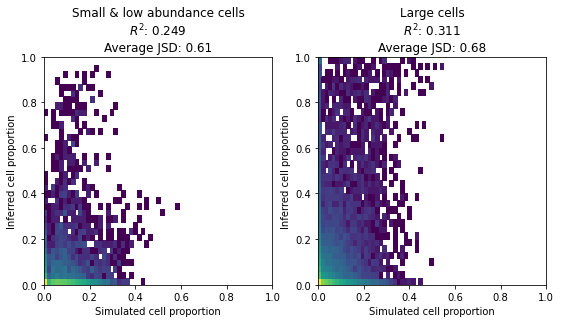

In [84]:
rcParams['figure.figsize'] = 9, 4.5
hist_by_category2(cell_proportions, seurat_cca_df, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

plt.savefig(os.path.split(seurat_path_1)[0] + '/cca_Cell_proportion_cor_by_size.pdf')

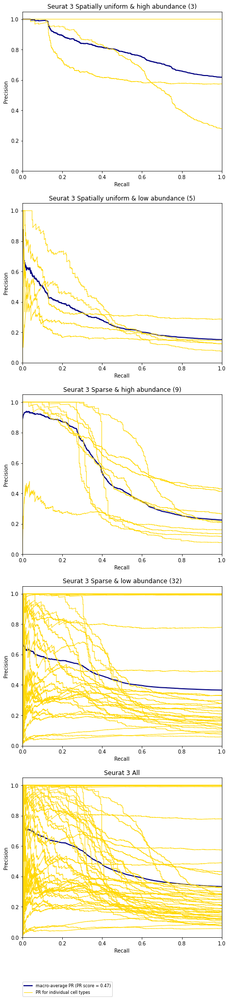

In [85]:
rcParams['figure.figsize'] = 7, 40
pos_cell_count = cell_count.values > 0.1
pr_by_category(pos_cell_count, seurat_cca_df, adata_vis_res.uns['design']['cell_types2zones'],
                 nrow=5, ncol=1,
                      title='Seurat 3',
               fig_path=fig_path)

plt.savefig(os.path.split(seurat_path_1)[0] + '/cca_ROC_all.pdf')

### Evaluate inferred cell propotion inferred with SPOTlight

In [86]:
# read cell proportions
spotlight_path_1 = results_folder + 'SPOTlight/results_hvg5k.csv'
spotlight_df = pd.read_csv(spotlight_path_1, sep=',', index_col='rn')
spotlight_df = spotlight_df.drop(columns=['res_ss'])

from re import sub

seu_index = [sub(' ', '.',i) for i in cell_proportions.columns]
seu_index = [sub('/', '.',i) for i in seu_index]
seu_index = [sub('-', '.',i) for i in seu_index]
seu_index = [sub('_', '.',i) for i in seu_index]

spotlight_df = spotlight_df[seu_index]
spotlight_df.columns = cell_proportions.columns

# compute proportions per location (already proportions)
#spotlight_df = (spotlight_df.T / spotlight_df.sum(1)).T

adata_vis_plt = adata_vis.copy()
spotlight_df = spotlight_df.loc[spotlight_df.index.isin(adata_vis_plt.obs_names)]
adata_vis_plt = adata_vis_plt[spotlight_df.index,:]

adata_vis_plt.obs['imagecol'] = adata_vis_plt.obsm['X_spatial'][:,0]
adata_vis_plt.obs['imagerow'] = - adata_vis_plt.obsm['X_spatial'][:,1]

Trying to set attribute `.obs` of view, copying.


In [87]:
spotlight_df = spotlight_df[cell_count.columns]

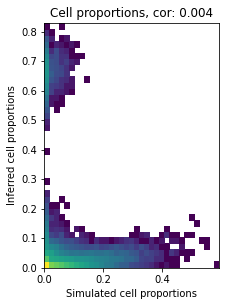

In [88]:
rcParams['figure.figsize'] = 4, 4.5
rcParams["axes.facecolor"] = "white"

plt.hist2d(cell_proportions.values.flatten(), 
           spotlight_df.values.flatten(),
           bins=[35, 41], norm=matplotlib.colors.LogNorm());
plt.xlabel('Simulated cell proportions');
plt.ylabel('Inferred cell proportions');
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Cell proportions, cor: ' \
          + str(np.round(np.corrcoef(cell_proportions.values.flatten(), 
           spotlight_df.values.flatten()), 3)[0,1]));

plt.savefig(os.path.split(spotlight_path_1)[0] + '/spotlightCell_proportion_cor.pdf')

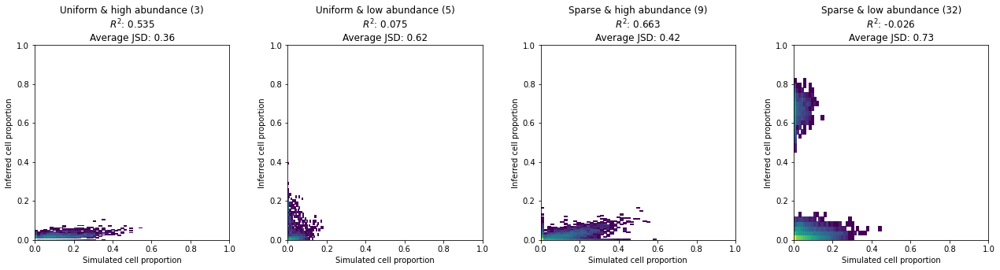

In [89]:
rcParams['figure.figsize'] = 18, 4.5
hist_by_category(cell_proportions, spotlight_df, adata_vis_res.uns['design']['cell_types2zones'],
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion')
plt.tight_layout()

plt.savefig(os.path.split(spotlight_path_1)[0] + '/spotlightCell_proportion_cor_by_group.pdf')

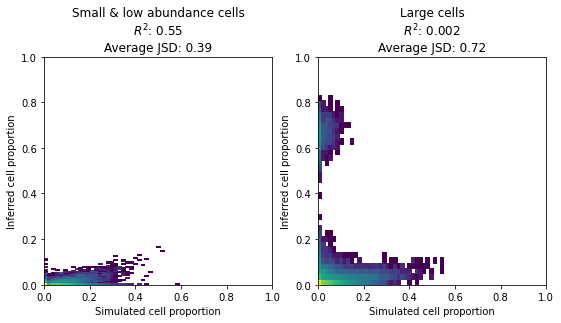

In [90]:
rcParams['figure.figsize'] = 9, 4.5
hist_by_category2(cell_proportions, spotlight_df, small_ind,
                 xlab='Simulated cell proportion',
                 ylab='Inferred cell proportion',
                 name1='Small & low abundance cells', name2='Large cells',
                 nrow=1, ncol=2, compute_kl=True)

plt.savefig(os.path.split(spotlight_path_1)[0] + '/spotlightCell_proportion_cor_by_size.pdf')

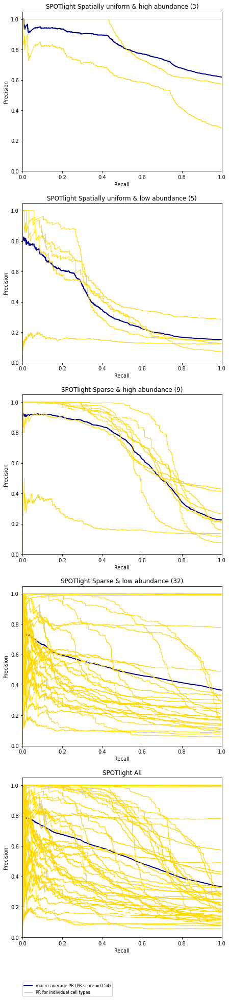

In [91]:
rcParams['figure.figsize'] = 7, 40
pos_cell_count = cell_count.values > 0.1
pr_by_category(pos_cell_count, spotlight_df, adata_vis_res.uns['design']['cell_types2zones'],
                 nrow=5, ncol=1,
                      title='SPOTlight',
               fig_path=fig_path)

plt.savefig(os.path.split(spotlight_path_1)[0] + '/spotlightROC_all.pdf')

## Compare per-spot accuracy of cell2location and stereoscope

### Compare the stereoscope and our model using precision-recall

In [92]:
import matplotlib as mpl
from matplotlib import pyplot as plt

with plt.style.context('seaborn'):
    seaborn_colors = mpl.rcParams['axes.prop_cycle'].by_key()['color']
seaborn_colors
sc.pl.palettes.default_102
    
def read_cell_maps(results_folder, run_name, cell_count, post_type='mean'):
    
    # read anndata object, extract data
    sp_data_file = results_folder + run_name + '/sp.h5ad'
    adata_vis_res = anndata.read(sp_data_file)
    
    # read pickle with extra info
    file = results_folder + run_name+'/model_.p'
    r = pickle.load(file = open(file, "rb"))
    
    # extract data
    from re import sub
    cell_count_columns = cell_count.columns

    spot_factors = adata_vis_res.obs[[post_type + '_spot_factors' + i for i in cell_count_columns]]
    spot_factors.columns =  [sub(post_type + '_spot_factors', '', i) for i in spot_factors.columns]

    #spot_factors_sd = adata_vis_res.obs[['sd_spot_factors' + i for i in cell_count_columns]]
    #spot_factors_sd.columns =  [sub('sd_spot_factors', '', i) for i in spot_factors_sd.columns]

    nUMI_factors = adata_vis_res.obs[[post_type + '_nUMI_factors' + i for i in cell_count_columns]]
    nUMI_factors.columns =  [sub(post_type + '_nUMI_factors', '', i) for i in nUMI_factors.columns]
    
    #spot_factors = spot_factors / spot_factors_sd

    infer_cell_count = spot_factors[cell_count.columns]
    infer_nUMI_count = nUMI_factors[cell_count.columns]
    
    infer_cell_proportions = (infer_cell_count.T / infer_cell_count.sum(1)).T
    
    return r['model_name'], infer_cell_proportions, infer_cell_count, infer_nUMI_count # spot_factors_sd

In [93]:
names = []
results = []
names_count = []
results_count = []
results_q05 = []
results_count_q05 = []

run_names = [
    'LocationModelLinearDependentWMultiExperiment_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
    'LocationModelLinearDependentWMultiExperimentNoMg_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
    'LocationModelHierarchicalWMultiExperiment_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
    'LocationModelMultiExperiment_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
    'LocationModelLinearDependentWMultiExperimentNoSegLs_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
    'LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha_1experiments_49clusters_2500locations_12080genes_defaults_ceps9_cps4_fps5_inf_shape01_gl2',
            ]

for n in run_names:
    name, infer_cell_prop, infer_cell_count, infer_nUMI_count = \
    read_cell_maps(results_folder, n, cell_count, post_type='mean')
    #infer_cell_count = (infer_cell_count.T / infer_cell_count.max(1)).T
    names.append(name)
    results.append(infer_cell_prop)
    names_count.append(name)
    results_count.append(infer_cell_count)
    
    name, infer_cell_prop, infer_cell_count, infer_nUMI_count = \
    read_cell_maps(results_folder, n, cell_count, post_type='q05')
    #infer_cell_count = (infer_cell_count.T / infer_cell_count.max(1)).T
    results_q05.append(infer_cell_prop)
    results_count_q05.append(infer_cell_count)

# add stereoscope
results.append(stereo_df[cell_count.columns])
results_count.append(stereo_df[cell_count.columns])
results_q05.append(stereo_df[cell_count.columns])
results_count_q05.append(stereo_df[cell_count.columns])
names.append('Stereoscope')

# add RCTD_df
results.append(RCTD_df[cell_count.columns])
results_count.append(RCTD_df[cell_count.columns])
results_q05.append(RCTD_df[cell_count.columns])
results_count_q05.append(RCTD_df[cell_count.columns])
names.append('RCTD')

# add Seurat 3
results.append(seurat_df[cell_count.columns])
results_count.append(seurat_df[cell_count.columns])
results_q05.append(seurat_df[cell_count.columns])
results_count_q05.append(seurat_df[cell_count.columns])
names.append('Seurat 3 PCA')

# add Seurat 3
results.append(seurat_cca_df[cell_count.columns])
results_count.append(seurat_cca_df[cell_count.columns])
results_q05.append(seurat_cca_df[cell_count.columns])
results_count_q05.append(seurat_cca_df[cell_count.columns])
names.append('Seurat 3 CCA')

# add SPOTlight
results.append(spotlight_df[cell_count.columns])
results_count.append(spotlight_df[cell_count.columns])
results_q05.append(spotlight_df[cell_count.columns])
results_count_q05.append(spotlight_df[cell_count.columns])
names.append('SPOTlight')

# add NNLS
results.append(nnls_df[cell_count.columns])
results_count.append(nnls_df[cell_count.columns])
results_q05.append(nnls_df[cell_count.columns])
results_count_q05.append(nnls_df[cell_count.columns])
names.append('NNLS')

In [94]:
for i, n in enumerate(names):
    if (type(n) is not str) and (type(n) is not type(None)):
        names[i] = n.__name__
            
names

['LocationModelLinearDependentWMultiExperiment',
 'LocationModelLinearDependentWMultiExperimentNoMg',
 'LocationModelHierarchicalWMultiExperiment',
 'LocationModelMultiExperiment',
 'LocationModelLinearDependentWMultiExperimentNoSegLs',
 'LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha',
 'Stereoscope',
 'RCTD',
 'Seurat 3 PCA',
 'Seurat 3 CCA',
 'SPOTlight',
 'NNLS']

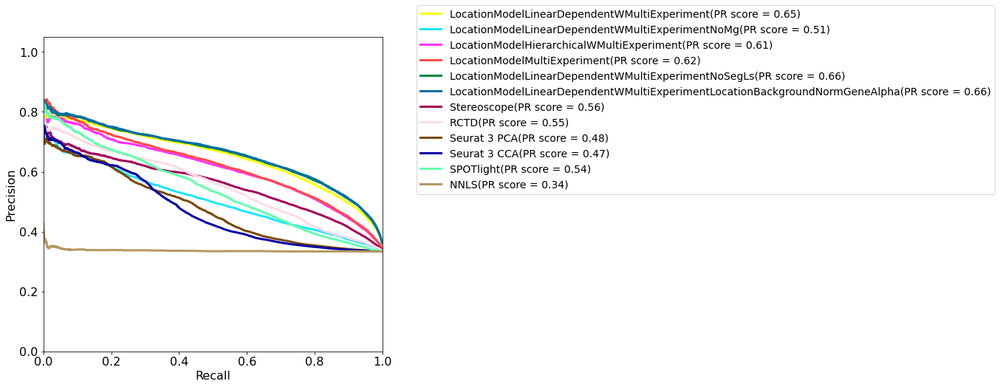

In [95]:
rcParams['figure.figsize'] = 20, 8
rcParams['font.size'] = 16
compare_precision_recall(pos_cell_count, results,
                         method_title=names, 
                         legend_loc=(1.1, 0.5))
plt.tight_layout()
plt.savefig(fig_path + '/ROC_comparison_all.pdf')

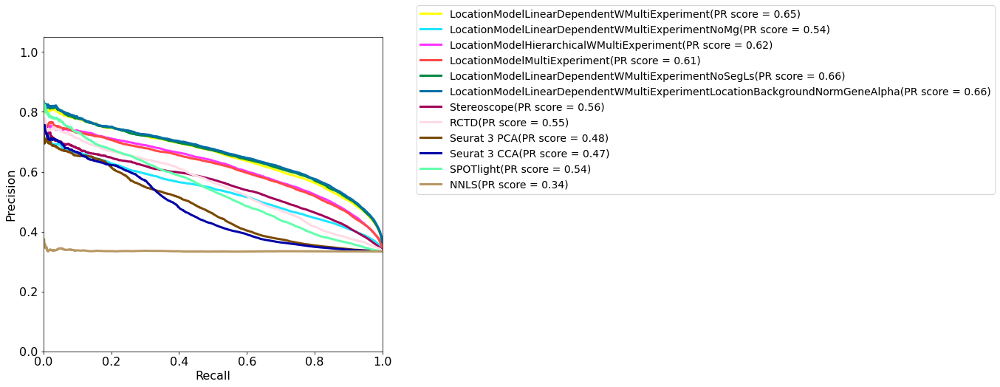

In [96]:
rcParams['figure.figsize'] = 20, 8
rcParams['font.size'] = 16
compare_precision_recall(pos_cell_count, results_count,
                         method_title=names, 
                         legend_loc=(1.1, 0.5))
plt.tight_layout()
plt.savefig(fig_path + '/ROC_comparison_all_count.pdf')

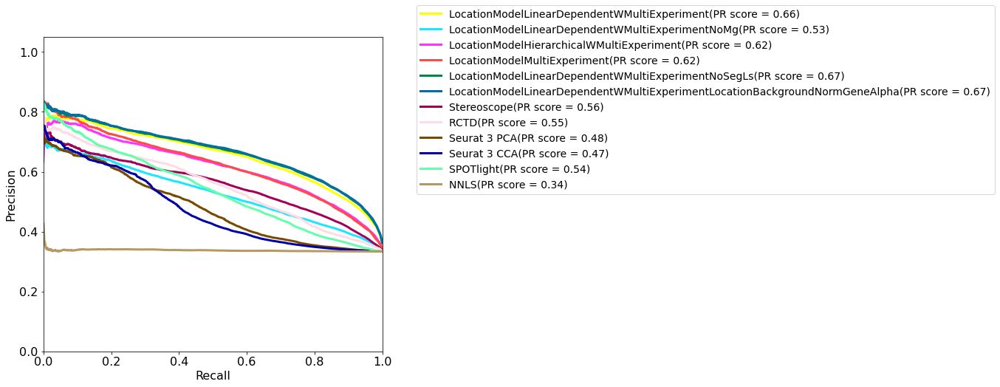

In [97]:
rcParams['figure.figsize'] = 20, 8
rcParams['font.size'] = 16
compare_precision_recall(pos_cell_count, results_q05,
                         method_title=names, 
                         legend_loc=(1.1, 0.5))
plt.tight_layout()
plt.savefig(fig_path + '/ROC_comparison_q05_all.pdf')

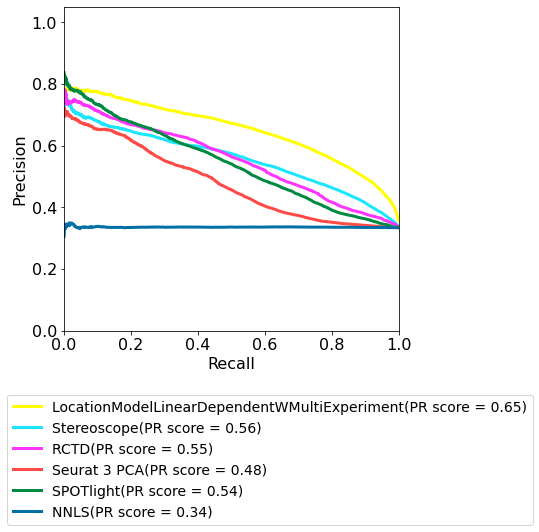

In [98]:
rcParams['figure.figsize'] = 7,8
rcParams['font.size'] = 16

mod_names = ['LocationModelLinearDependentWMultiExperiment',
             'Stereoscope',
             'RCTD',
             'Seurat 3 PCA',
             'SPOTlight',
             'NNLS'
            ]

results_dict = {}
for i, n in enumerate(names):
    results_dict[n] = results[i]

results_dict_sel = {}
for i, n in enumerate(mod_names):
    results_dict_sel[n] = results_dict[n]

    
if False:
    compare_precision_recall(pos_cell_count, list(results_dict_sel.values()),
                             method_title=list(results_dict_sel.keys()),
                             legend_loc=(-0.17, -0.6), curve='ROC')
    plt.tight_layout()
    plt.savefig(fig_path + '/ROC_comparison_selected_FigS2.pdf')
    plt.show()
    
compare_precision_recall(pos_cell_count, list(results_dict_sel.values()),
                         method_title=list(results_dict_sel.keys()),
                         legend_loc=(-0.17, -0.6))
plt.tight_layout()
plt.savefig(fig_path + '/ROC_comparison_selected_FigS2.pdf')

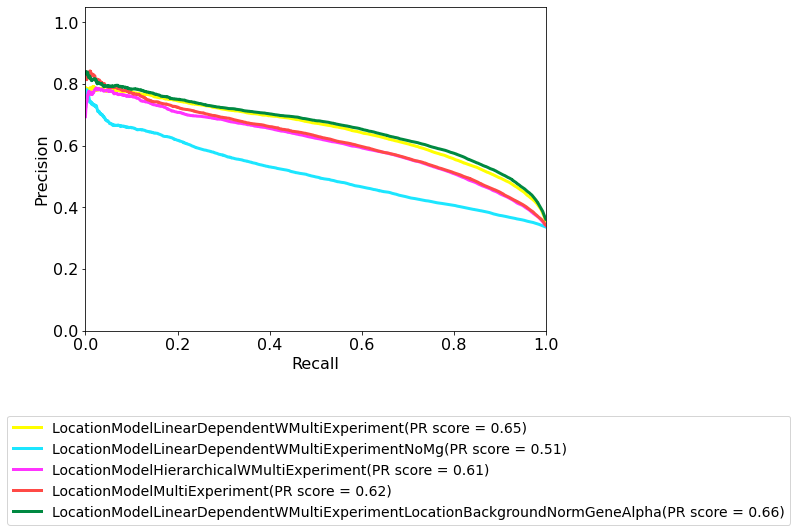

In [99]:
rcParams['figure.figsize'] = 10,8
rcParams['font.size'] = 16

mod_names = ['LocationModelLinearDependentWMultiExperiment',
 'LocationModelLinearDependentWMultiExperimentNoMg',
 'LocationModelHierarchicalWMultiExperiment',
 'LocationModelMultiExperiment',
 'LocationModelLinearDependentWMultiExperimentLocationBackgroundNormGeneAlpha'
            ]

results_dict = {}
for i, n in enumerate(names):
    results_dict[n] = results[i]

results_dict_sel = {}
for i, n in enumerate(mod_names):
    results_dict_sel[n] = results_dict[n]

if False:
    compare_precision_recall(pos_cell_count, list(results_dict_sel.values()),
                             method_title=list(results_dict_sel.keys()),
                             legend_loc=(-0.17, -0.6), curve='ROC')
    plt.tight_layout()
    plt.savefig(fig_path + '/ROC_comparison_simplified_FigS2.pdf')
    plt.show()

compare_precision_recall(pos_cell_count, list(results_dict_sel.values()),
                         method_title=list(results_dict_sel.keys()),
                         legend_loc=(-0.17, -0.6), curve='PR')
plt.tight_layout()
plt.savefig(fig_path + '/PR_comparison_simplified_FigS2.pdf')
plt.show()

#### Compares using RMSE on proportions

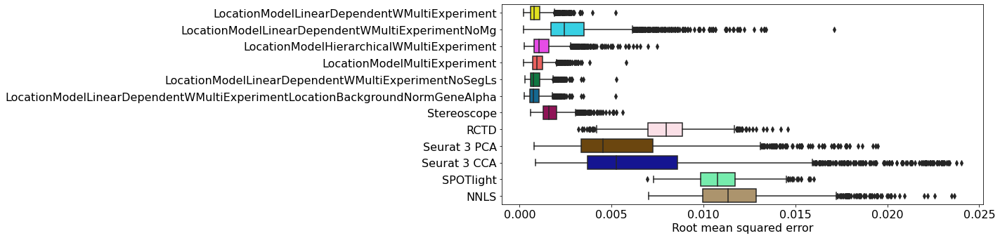

In [100]:
from sklearn.metrics import mean_squared_error
rmse = pd.DataFrame()
for i in range(len(results)):
    rmse[names[i]] = ((cell_proportions - results[i]) ** 2).mean(1)

rcParams['figure.figsize'] = 20, 5
sns.boxplot(data=rmse, orient="h", palette=sc.pl.palettes.default_102).set(
    xlabel='Root mean squared error'
)
plt.tight_layout()
plt.savefig(fig_path + '/RMSE_comparison_all.pdf')
plt.show()

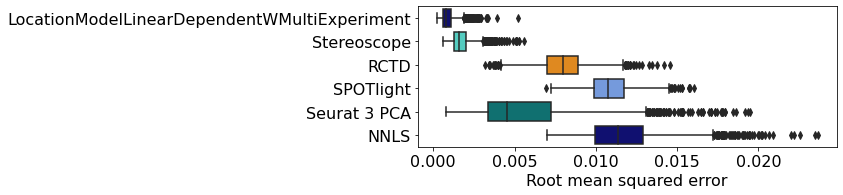

In [101]:
rcParams['figure.figsize'] = 12, 3
rcParams['pdf.fonttype'] = 42
rcParams['font.size'] = 16

mod_names = ['LocationModelLinearDependentWMultiExperiment',
             'Stereoscope',
             'RCTD',
             'SPOTlight',
             'Seurat 3 PCA',
             'NNLS']

from itertools import cycle
colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal'])
my_palette = dict(zip(mod_names, colors))

sns.boxplot(data=rmse[mod_names], orient="h", palette=my_palette).set(
    xlabel='Root mean squared error'
)
plt.tight_layout()
plt.savefig(fig_path + '/RMSE_comparison_selected.pdf')
plt.show()

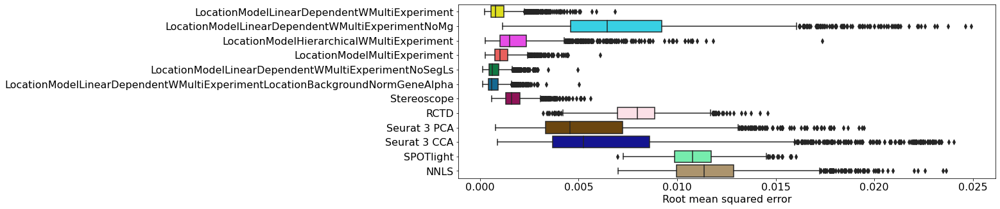

In [102]:
rmse_q05 = pd.DataFrame()
for i in range(len(results)):
    rmse_q05[names[i]] = ((cell_proportions - results_q05[i]) ** 2).mean(1)
    
rcParams['figure.figsize'] = 15, 5
sns.boxplot(data=rmse_q05, orient="h", palette=sc.pl.palettes.default_102).set(
    xlabel='Root mean squared error'
)
plt.show()

## Plot ground truth and cell estimates in 2D

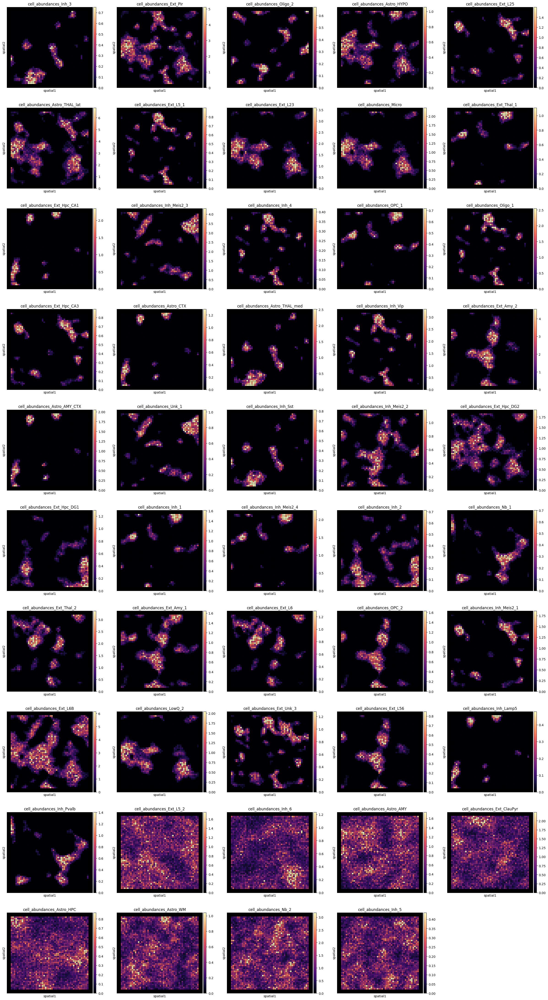

In [104]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (5,5), 'axes.facecolor': "black"}):
    sc.pl.spatial(adata_vis_res, cmap='magma',
                  color=[f'cell_abundances_{i}' for i in cell_proportions.columns], ncols=5, 
                  size=0.015, 
                  img_key=None,
                  alpha_img=1, vmin=0, vmax='p99.2',
                  show=True, return_fig=False)

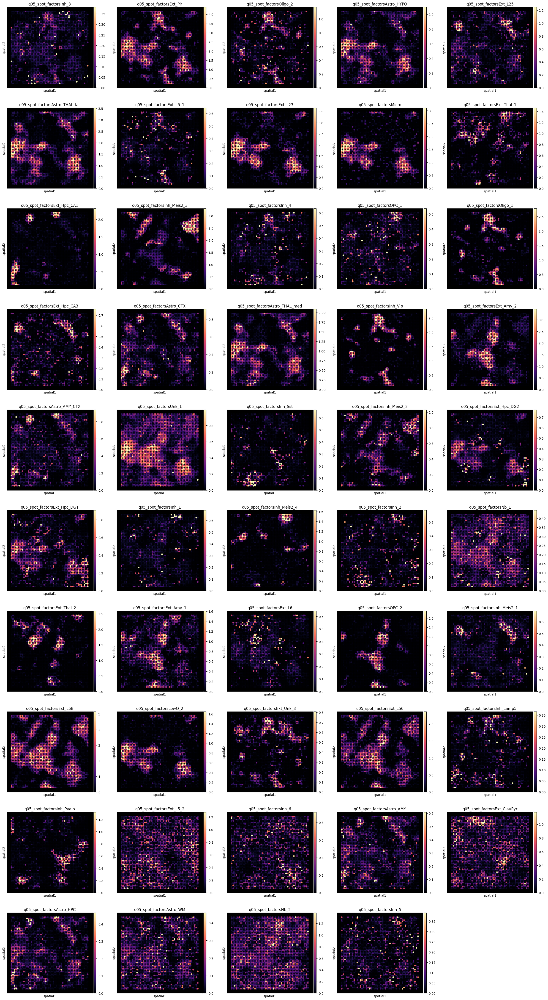

In [105]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
with mpl.rc_context({'figure.figsize': (5,5), 'axes.facecolor': "black"}):
    sc.pl.spatial(adata_vis_res, cmap='magma',
                  color=[f'q05_spot_factors{i}' for i in cell_proportions.columns], ncols=5, 
                  size=0.015, 
                  img_key=None,
                  alpha_img=1, vmin=0, vmax='p99.2',
                  show=True, return_fig=False)

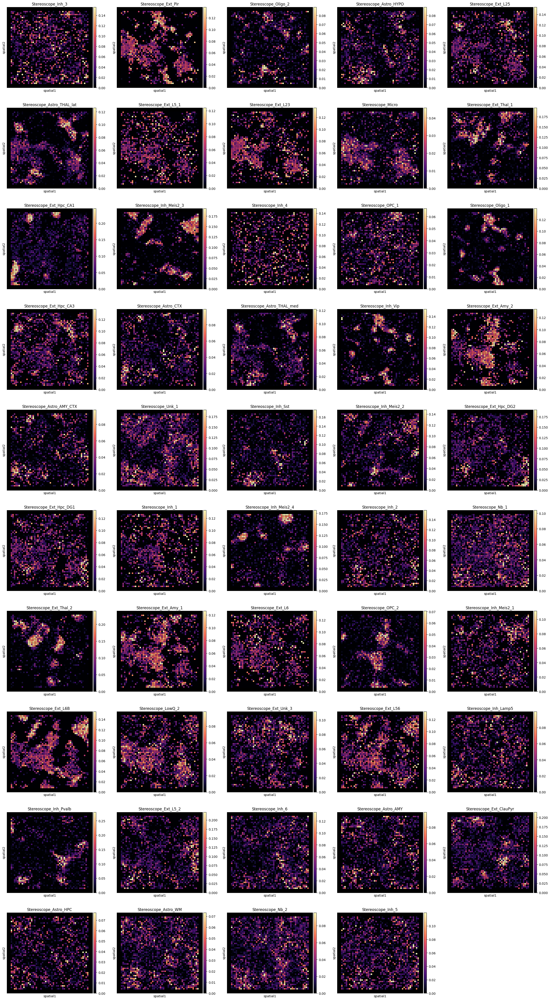

In [106]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text

adata_vis_res.obs[[f'Stereoscope_{i}' for i in cell_proportions.columns]] \
= results_dict['Stereoscope']

with mpl.rc_context({'figure.figsize': (5,5), 'axes.facecolor': "black"}):
    sc.pl.spatial(adata_vis_res, cmap='magma',
                  color=[f'Stereoscope_{i}' for i in cell_proportions.columns], ncols=5, 
                  size=0.015, 
                  img_key=None,
                  alpha_img=1, vmin=0, vmax='p99.2',
                  show=True, return_fig=False)

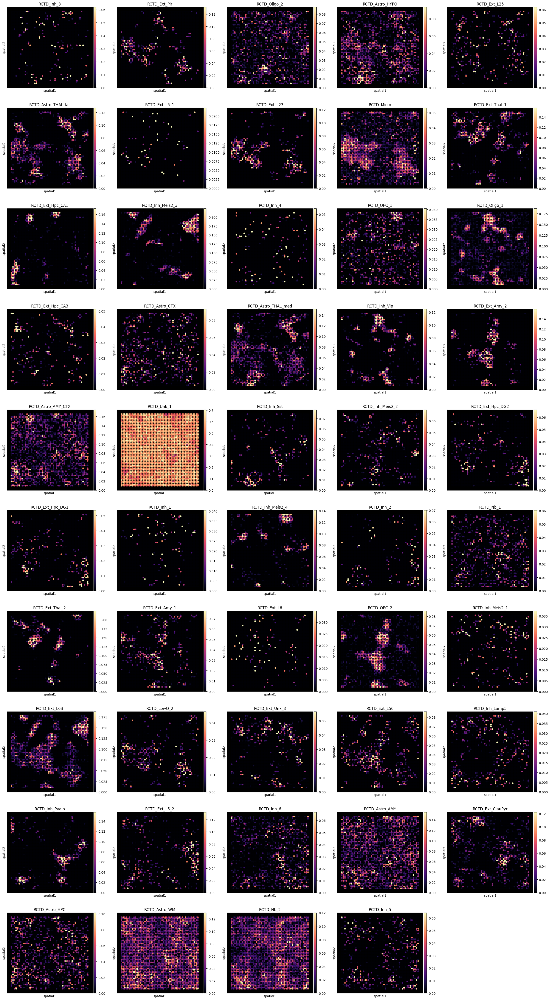

In [107]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text

adata_vis_res.obs[[f'RCTD_{i}' for i in cell_proportions.columns]] \
= results_dict['RCTD']

with mpl.rc_context({'figure.figsize': (5,5), 'axes.facecolor': "black"}):
    sc.pl.spatial(adata_vis_res, cmap='magma',
                  color=[f'RCTD_{i}' for i in cell_proportions.columns], ncols=5, 
                  size=0.015, 
                  img_key=None,
                  alpha_img=1, vmin=0, vmax='p99.2',
                  show=True, return_fig=False)

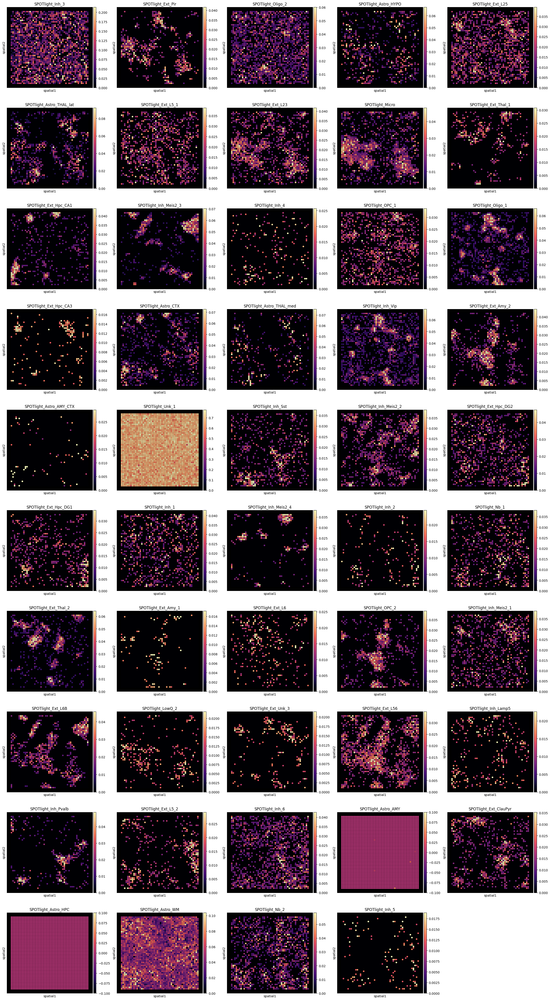

In [108]:
mpl.rc_file_defaults()
mpl.rcParams['pdf.fonttype'] = 42 # enables correct plotting of text

adata_vis_res.obs[[f'SPOTlight_{i}' for i in cell_proportions.columns]] \
= results_dict['SPOTlight']

with mpl.rc_context({'figure.figsize': (5,5), 'axes.facecolor': "black"}):
    sc.pl.spatial(adata_vis_res, cmap='magma',
                  color=[f'SPOTlight_{i}' for i in cell_proportions.columns], ncols=5, 
                  size=0.015, 
                  img_key=None,
                  alpha_img=1, vmin=0, vmax='p99.2',
                  show=True, return_fig=False)